## Notes:
* Need a good dataset with camera parameters defined
* Need another model that takes into account the stereo problem

In [ ]:
import os
os.environ["OPENCV_IO_ENABLE_OPENEXR"]="1"

In [1]:
from typing import List, Tuple

import os

import numpy as np

from PIL import Image

import utils

import torch

### Configure the dataset

In [2]:
dataset = utils.StereoDataset(
    imgs_path="environment-walking",
    depth_path="environment-walking-depth",
)

trainloader, validloader, testloader = utils.get_train_valid_test_loaders(dataset, batchsize=32, split=(0.8, 0.1, 0.1))
# sanity check
print(len(dataset))

1994


In [3]:
items = next(iter(trainloader))

In [4]:
left, right, ldepth, rdepth = items

print(left.shape, right.shape, ldepth.shape, rdepth.shape)

torch.Size([32, 3, 128, 128]) torch.Size([32, 3, 128, 128]) torch.Size([32, 1, 128, 128]) torch.Size([32, 1, 128, 128])


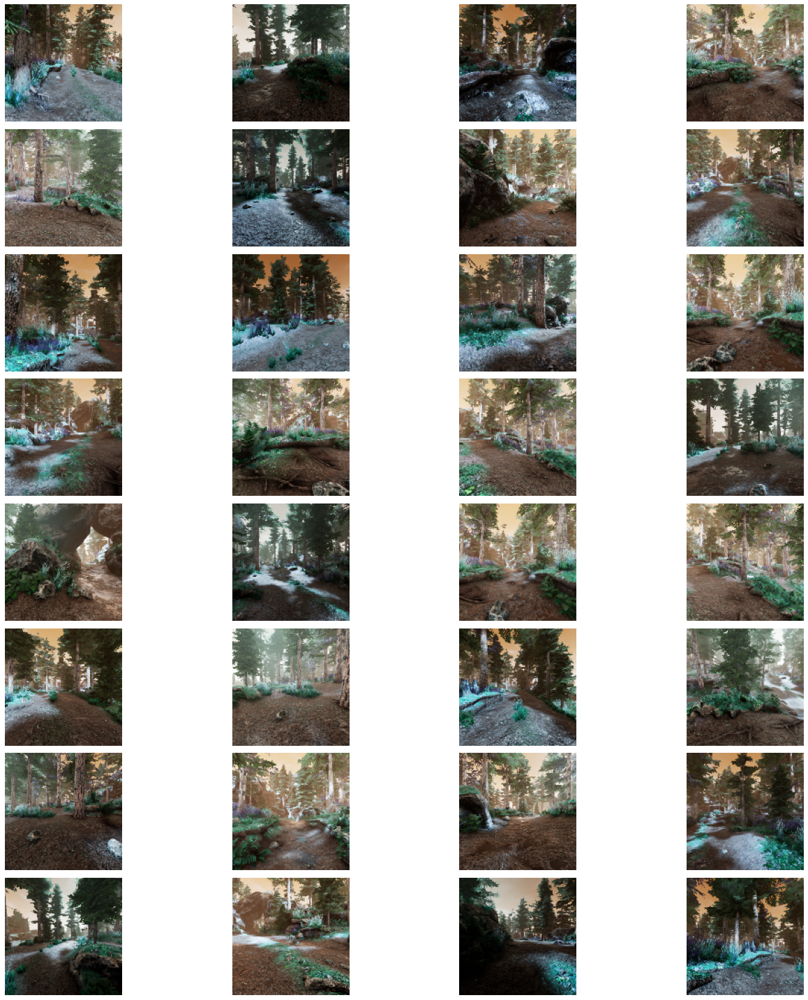

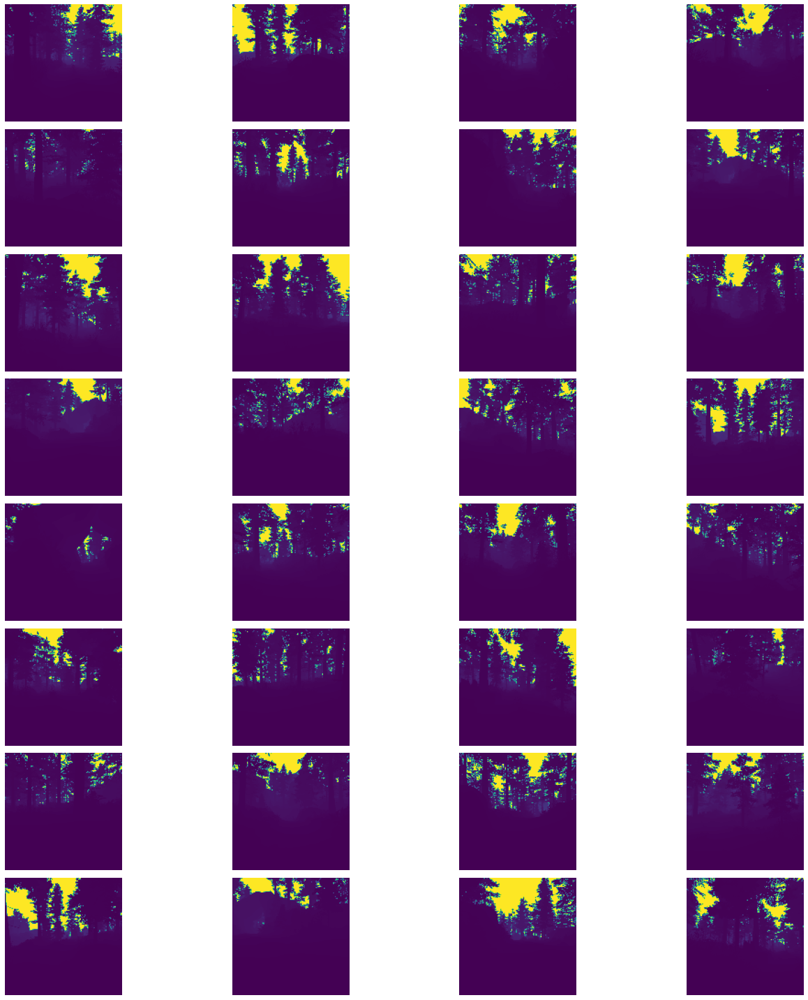

In [5]:
utils.display_batch(left)
utils.display_batch(ldepth)

In [6]:
ldepth.max()

tensor(1.)

In [7]:
# # get the number of batches in the trainloader
# max_list = []

# # get the mean and the standard deviation of the depth images
# for left, right, ldepth, rdepth in trainloader:
#     max_list.append(ldepth.max())
    
# # get the mean and the standard deviation of the depth images
# maxx = np.array(max_list).max()

# print(maxx)

In [8]:
from models import *
# model = DepthNet(6, use_transpose_conv=True).cuda()
# model = model.cuda()
# res = model(torch.randn(1, 6, 256, 256).cuda())
# res.shape

In [9]:
# clear cuda memory
torch.cuda.empty_cache()

In [10]:
class LogLoss(nn.Module):
    '''Ensures that the loss is always positive and greater than 0'''
    def __init__(self):
        super(LogLoss, self).__init__()
        
    def forward(self, pred, target):
        pred_sum = torch.sum(pred)
        target_sum = torch.sum(target)
        bs = pred.shape[0]
        # calculate the mean log loss
        return (torch.log(pred_sum) - torch.log(target_sum)).abs()/bs
    
    
class DepthLoss(nn.Module):
    '''Gets the depth loss'''
    def __init__(self):
        super(DepthLoss, self).__init__()
        self.log_loss = LogLoss()
        self.mse_loss = nn.MSELoss()
        
    def forward(self, pred, target):
        # get the log loss
        log_loss = self.log_loss(pred, target)
        # get the mse loss
        mse_loss = self.mse_loss(pred, target)
        # return the sum of the two losses
        return log_loss + mse_loss

In [11]:
from torch.optim import Adam
# from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.optim.lr_scheduler import ExponentialLR

model = DepthNet(6, use_transpose_conv=True)
criterion = DepthLoss()
optimizer = Adam(model.parameters(), lr=1e-3)

inputs = {
    "model": model,
    "criterion": criterion,
    "optimizer": optimizer,
    "trainloader": trainloader,
    "validloader": validloader,
    "epochs": 1200,
    "device": "cuda",
    # "scheduler": ReduceLROnPlateau(optimizer, patience=5, verbose=True),
    "scheduler": ExponentialLR(optimizer, gamma=0.99, verbose=True),
    'training_losses': [],
    'validation_losses': [],
    # "pretrained_model":"best_model_log_mse.pth"
}

In [ ]:
import wandb

wandb.init(project="depth-estimation-mac", config=inputs)

In [12]:
from typing import Dict, Any

import matplotlib.pyplot as plt

def train(**inputs:Dict[str,Any])->None:
    '''trains the model given the inputs
    
    Parameters:
    -----------
        model: torch.nn.Module
            the model to train
        criterion: torch.nn.Loss
            the loss function
        optimizer: torch.optim.Optimizer
            the optimizer
        trainloader: torch.utils.data.DataLoader
            the training data loader
        validloader: torch.utils.data.DataLoader
            the validation data loader
        epochs: int
            number of epochs to train
        device: str
            device to train on
        scheduler: torch.optim.lr_scheduler
            the learning rate scheduler
        training_losses: List[float]
            list to store training losses
        validation_losses: List[float]
            list to store validation losses
    '''
    model = inputs["model"]
    criterion = inputs["criterion"]
    optimizer = inputs["optimizer"]
    trainloader = inputs["trainloader"]
    validloader = inputs["validloader"]
    epochs = inputs["epochs"]
    device = inputs["device"]
    scheduler = inputs["scheduler"]
    training_losses = inputs["training_losses"]
    validation_losses = inputs["validation_losses"]
    
    print("Training on {}...".format(device))
          
    # load pretrained model if available
    if inputs.get('pretrained_model'):
        print("Loading pretrained model...")
        model.load_state_dict(torch.load(inputs['pretrained_model']))
        
    # move model to device
    model.to(device)
    
    # set bestloss to track the best validation loss and save the best model
    best_loss = np.inf
    
    # loop through epochs
    for epoch in range(epochs):
        train_loss = 0
        valid_loss = 0
        
        # set model to train mode and train
        model.train()
        # loop through batches
        for left, right, ldepth, rdepth in trainloader:
            # concatenate left and right images
            x = torch.cat((left, right), dim=1)
            x = x.to(device)
            ldepth = ldepth.to(device)
            
            pred_depth = model(x)
            loss = criterion(pred_depth, ldepth)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            
        # validate
        model.eval()
        with torch.no_grad():
            for left, right, ldepth, rdepth in validloader:
                # concatenate left and right images
                x = torch.cat((left, right), dim=1)
                x = x.to(device)
                ldepth = ldepth.to(device)
                
                pred_depth = model(x)
                loss = criterion(pred_depth, ldepth)
                
                valid_loss += loss.item()
            
            # for visualization purposes
            left, right, ldepth, _ = next(iter(validloader))
            x = torch.cat((left, right), dim=1)
            x = x.to(device)
            pred_depth = model(x)
                           
        # verbose
        training_losses.append(train_loss/len(trainloader))
        validation_losses.append(valid_loss/len(validloader))
        
        # print(f"Epoch: {epoch+1}/{epochs}.. Training Loss: {training_losses[-1]:.6f}.. Validation Loss: {validation_losses[-1]:.6f}")
        wandb.log({"training_loss": train_loss/len(trainloader), "validation_loss": valid_loss/len(validloader)}, step=epoch)
        
        if validation_losses[-1] < best_loss:
            print("loss decreased from {:.6f} to {:.6f} -> saving best model.".format(best_loss, validation_losses[-1]) )
            best_loss = validation_losses[-1]
            torch.save(model.state_dict(), "best_model_inv_conv.pth")
            
        scheduler.step(valid_loss/len(validloader))

        # wandb.log({"test_image": wandb.Image(left[0].permute(1, 2, 0).detach().cpu().numpy(), caption="Left Image")})
        
        # display right left and depth images
        for i in range(len(left)):
            pred_depth_image = pred_depth[i].detach().cpu().squeeze().numpy()
            ldepth_image = ldepth[i].detach().cpu().squeeze().numpy()
            # normalize pred_depth_image
            pred_depth_image = (pred_depth_image - pred_depth_image.min())/(pred_depth_image.max() - pred_depth_image.min())
            # normalize ldepth_image
            ldepth_image = (ldepth_image - ldepth_image.min())/(ldepth_image.max() - ldepth_image.min())
            image_array = [wandb.Image(left[i].permute(1, 2, 0).detach().cpu().numpy(), caption="Left Image"), wandb.Image(right[i].permute(1, 2, 0).detach().cpu().numpy(), caption="Right Image"), wandb.Image(pred_depth_image, caption="Depth Image"), wandb.Image(ldepth_image, caption="Ground Truth Depth Image")]
            # images = wandb.Image(image_array, caption="Left, Right, Predicted Depth, Ground Truth")
            wandb.log({f"image{i}": image_array}, step=epoch)

        # fig, ax = plt.subplots(1, 4, figsize=(15, 15))
        # ax[0].imshow(left[0].permute(1, 2, 0).detach().cpu().numpy())
        # ax[0].set_title("Left Image")
        # ax[1].imshow(right[0].permute(1, 2, 0).detach().cpu().numpy())
        # ax[1].set_title("Right Image")
        # ax[2].imshow(pred_depth[0].detach().cpu().squeeze().numpy())
        # ax[2].set_title("Depth Image")
        # ax[3].imshow(ldepth[0].detach().cpu().squeeze().numpy())
        # ax[3].set_title("Ground Truth Depth Image")
        # plt.show()
        
        # plt.plot(training_losses, label='Training loss')
        # plt.plot(validation_losses, label='Validation loss')
        # plt.legend(frameon=False)
        # plt.show()

Training on cuda...
Epoch: 1/100.. Training Loss: 0.061887.. Validation Loss: 0.086097
loss decreased from inf to 0.086097 -> saving best model.


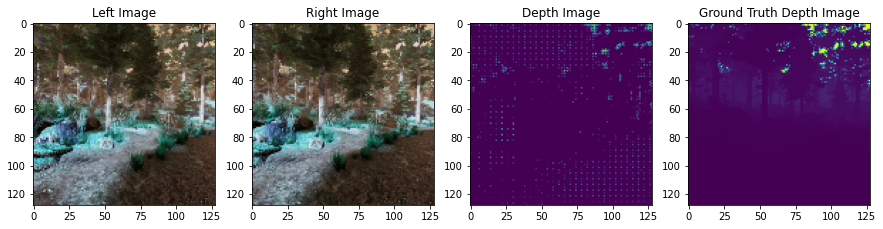

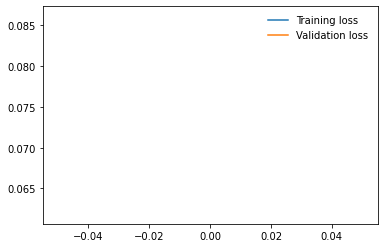

Epoch: 2/100.. Training Loss: 0.041339.. Validation Loss: 0.036959
loss decreased from 0.086097 to 0.036959 -> saving best model.


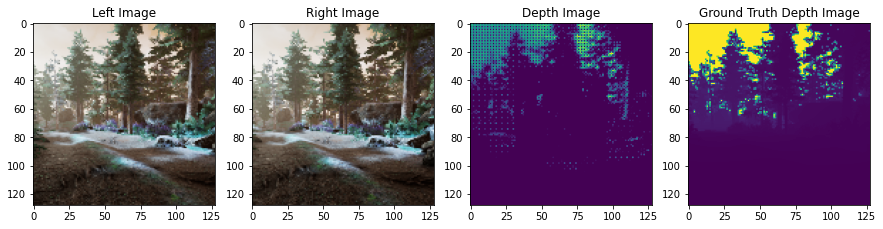

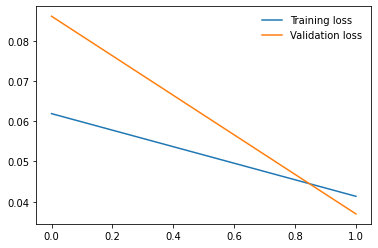

Epoch: 3/100.. Training Loss: 0.029223.. Validation Loss: 0.016514
loss decreased from 0.036959 to 0.016514 -> saving best model.


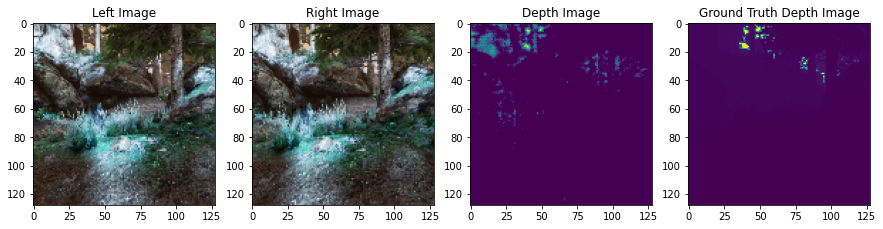

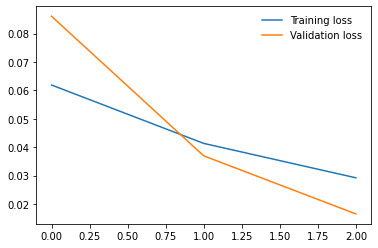

Epoch: 4/100.. Training Loss: 0.016641.. Validation Loss: 0.029941


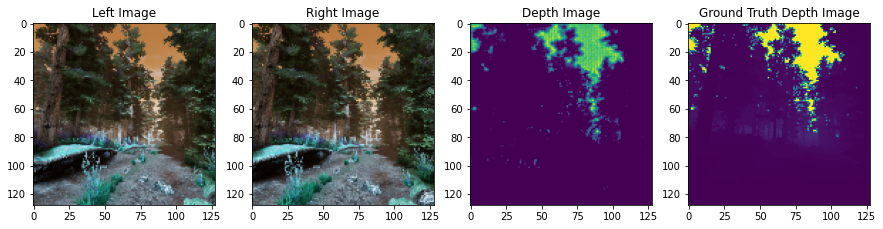

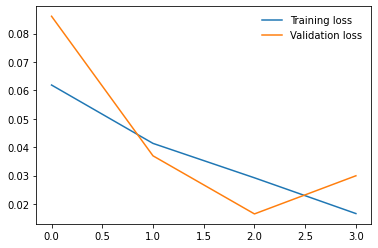

Epoch: 5/100.. Training Loss: 0.017829.. Validation Loss: 0.013253
loss decreased from 0.016514 to 0.013253 -> saving best model.


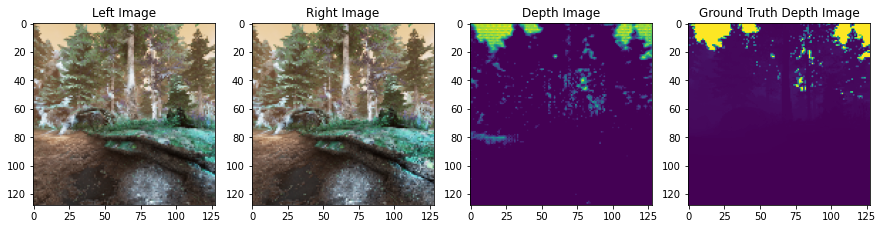

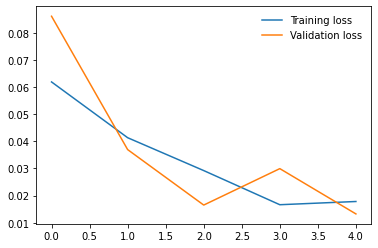

Epoch: 6/100.. Training Loss: 0.015342.. Validation Loss: 0.010620
loss decreased from 0.013253 to 0.010620 -> saving best model.


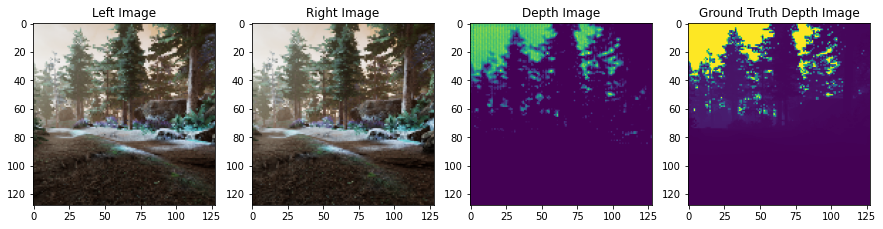

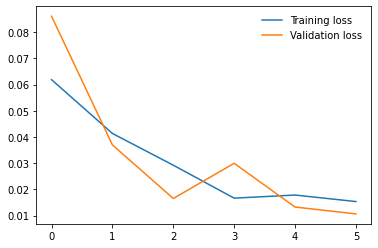

Epoch: 7/100.. Training Loss: 0.012034.. Validation Loss: 0.019043


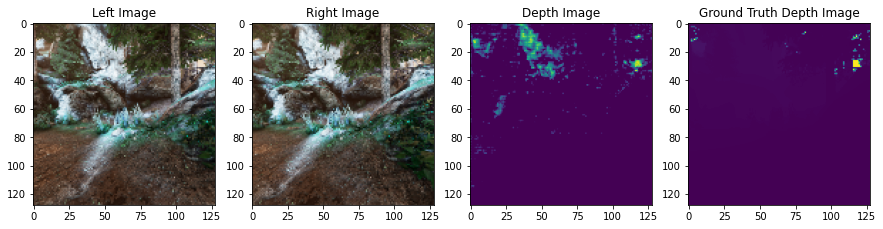

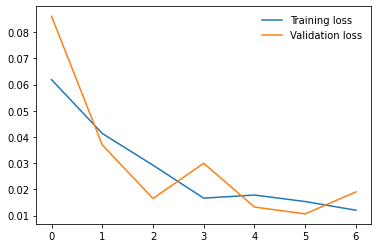

Epoch: 8/100.. Training Loss: 0.014048.. Validation Loss: 0.023663


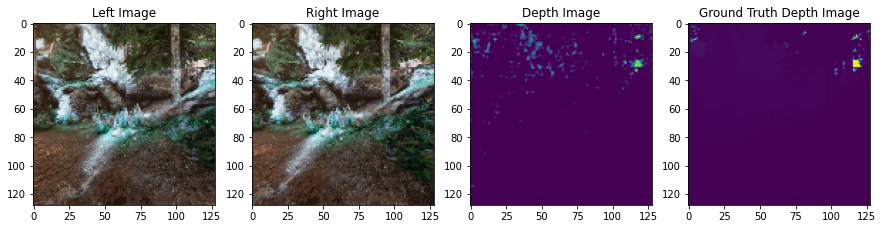

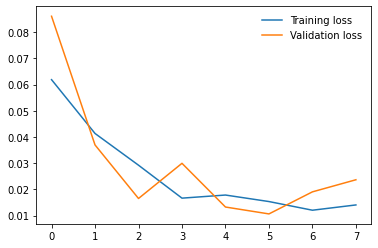

Epoch: 9/100.. Training Loss: 0.012689.. Validation Loss: 0.009214
loss decreased from 0.010620 to 0.009214 -> saving best model.


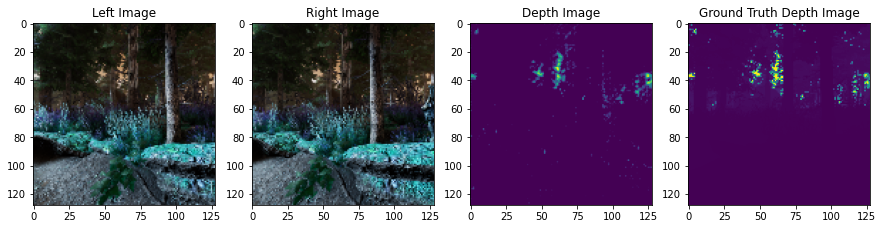

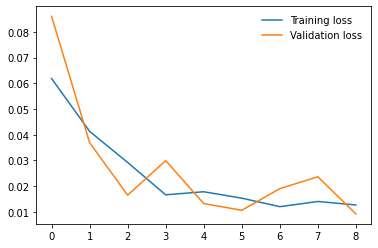

Epoch: 10/100.. Training Loss: 0.012045.. Validation Loss: 0.022446


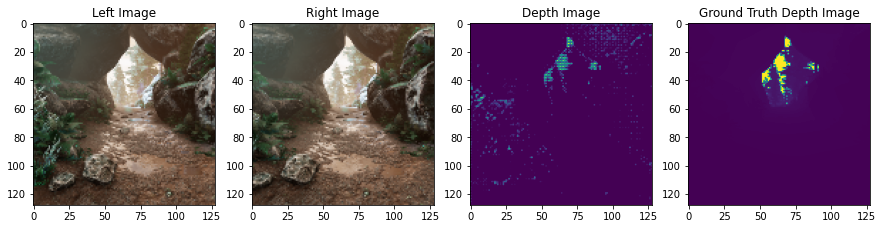

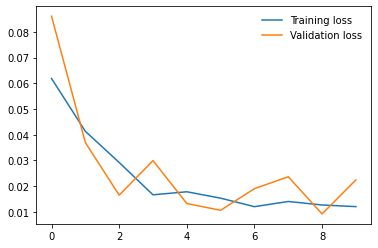

Epoch: 11/100.. Training Loss: 0.011934.. Validation Loss: 0.016262


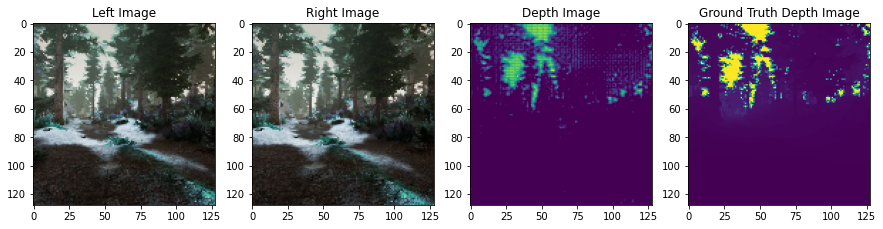

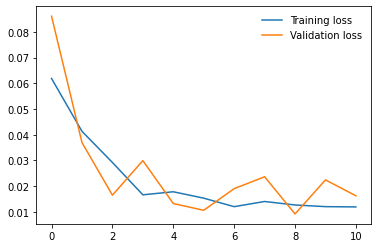

Epoch: 12/100.. Training Loss: 0.011003.. Validation Loss: 0.034099


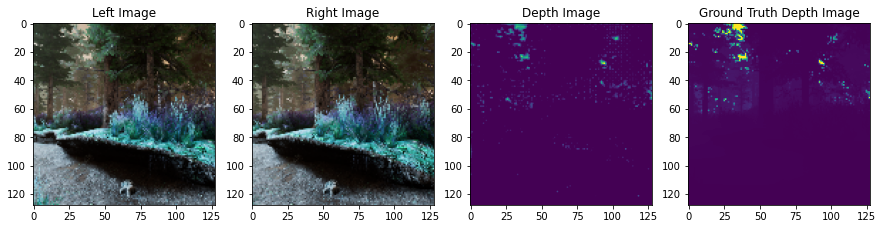

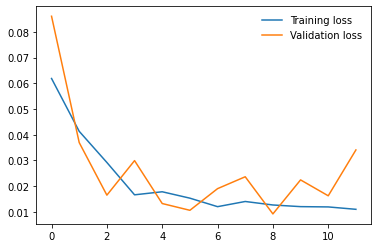

Epoch: 13/100.. Training Loss: 0.011438.. Validation Loss: 0.009324


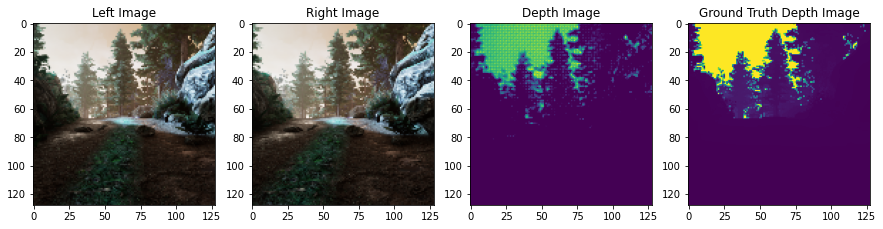

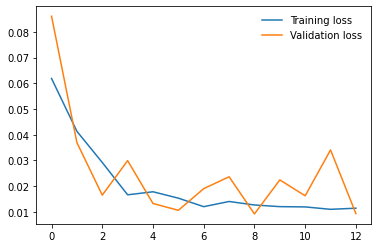

Epoch: 14/100.. Training Loss: 0.010612.. Validation Loss: 0.008321
loss decreased from 0.009214 to 0.008321 -> saving best model.


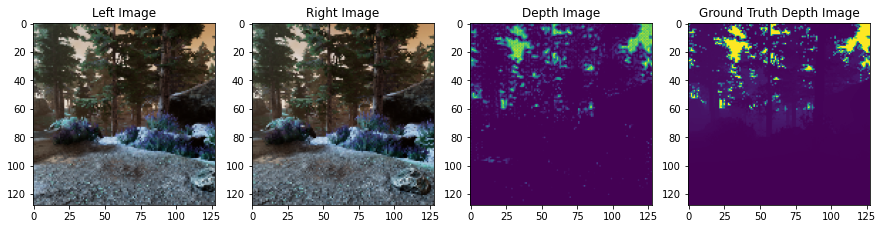

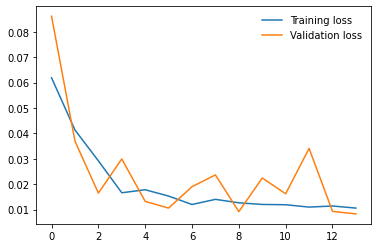

Epoch: 15/100.. Training Loss: 0.012258.. Validation Loss: 0.010471


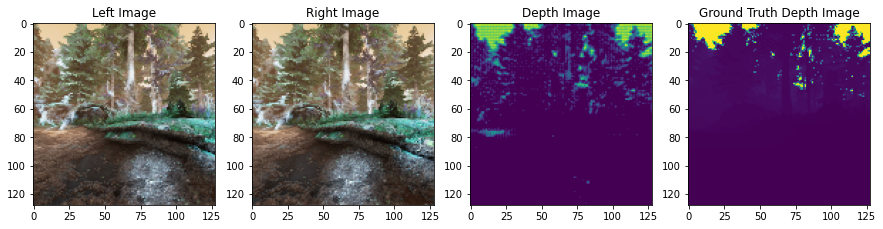

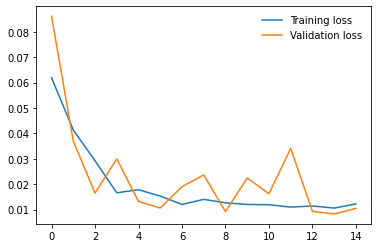

Epoch: 16/100.. Training Loss: 0.009507.. Validation Loss: 0.010483


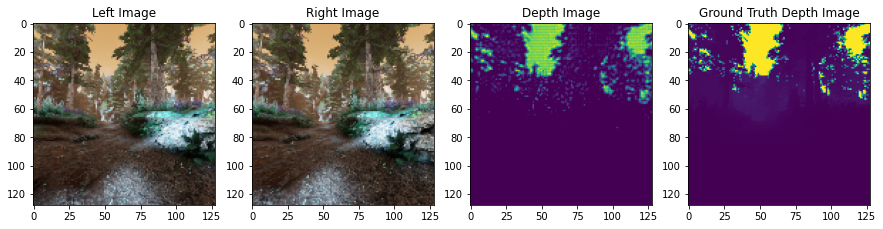

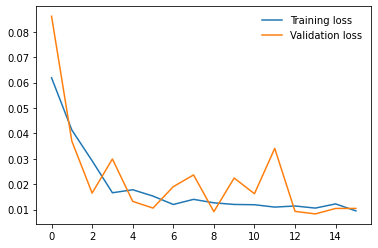

Epoch: 17/100.. Training Loss: 0.009124.. Validation Loss: 0.007677
loss decreased from 0.008321 to 0.007677 -> saving best model.


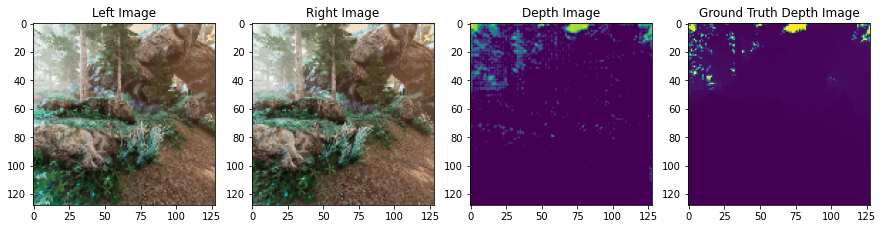

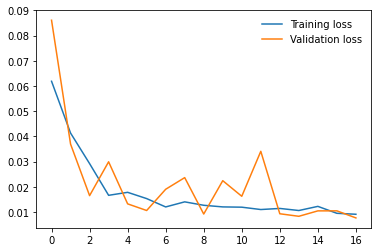

Epoch: 18/100.. Training Loss: 0.010421.. Validation Loss: 0.029455


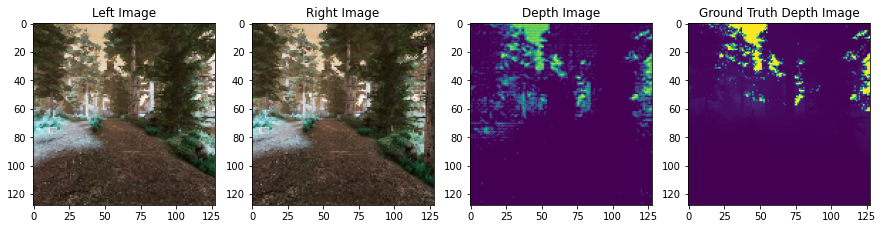

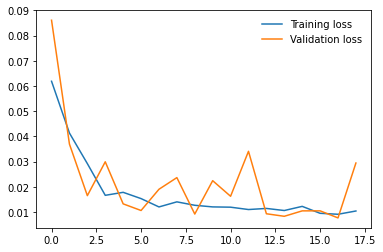

Epoch: 19/100.. Training Loss: 0.010516.. Validation Loss: 0.019028


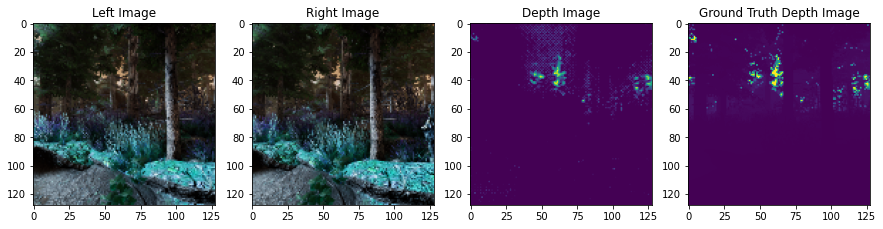

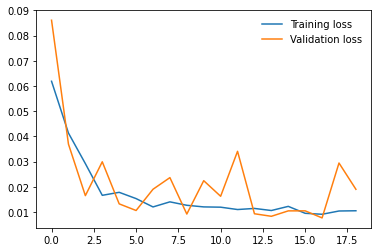

Epoch: 20/100.. Training Loss: 0.010549.. Validation Loss: 0.033337


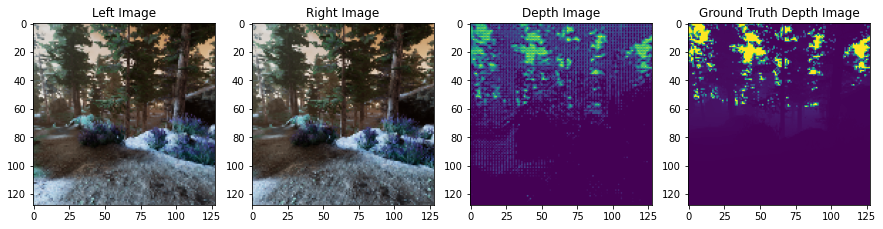

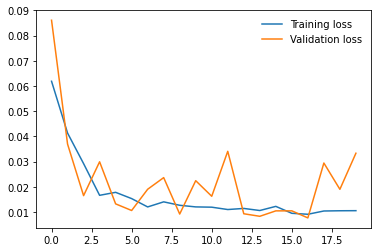

Epoch: 21/100.. Training Loss: 0.010174.. Validation Loss: 0.008802


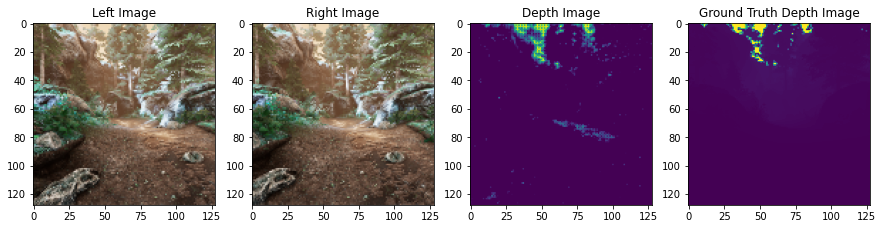

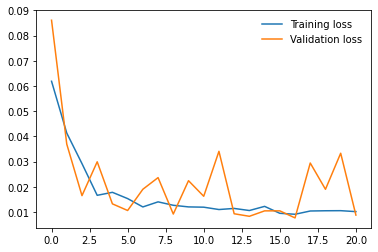

Epoch: 22/100.. Training Loss: 0.009497.. Validation Loss: 0.011864


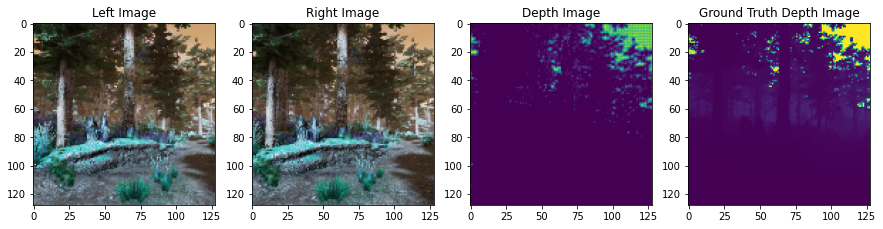

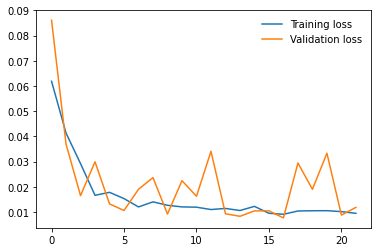

Epoch: 23/100.. Training Loss: 0.009192.. Validation Loss: 0.011169
Epoch    23: reducing learning rate of group 0 to 1.0000e-04.


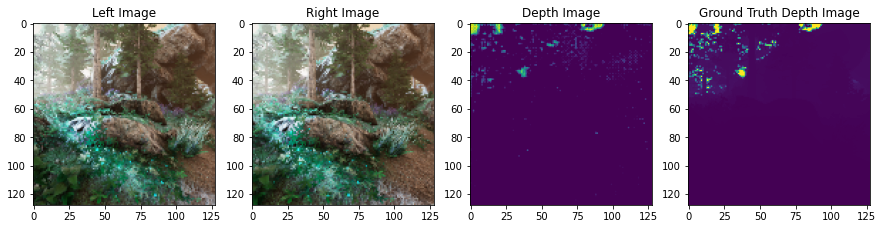

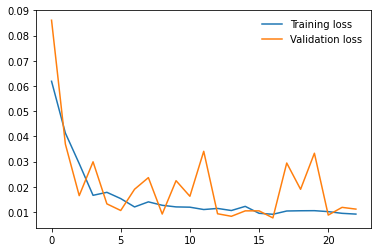

Epoch: 24/100.. Training Loss: 0.007897.. Validation Loss: 0.007628
loss decreased from 0.007677 to 0.007628 -> saving best model.


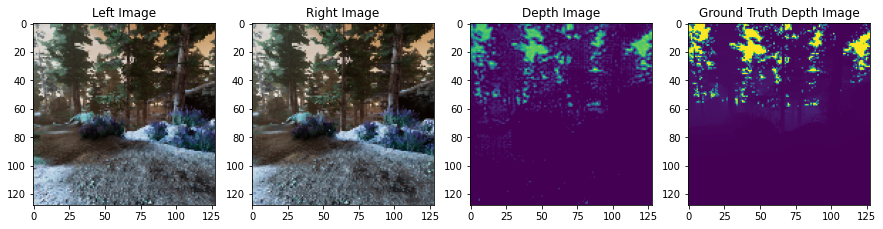

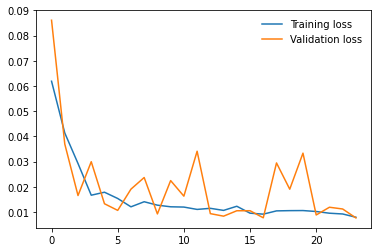

Epoch: 25/100.. Training Loss: 0.007129.. Validation Loss: 0.007122
loss decreased from 0.007628 to 0.007122 -> saving best model.


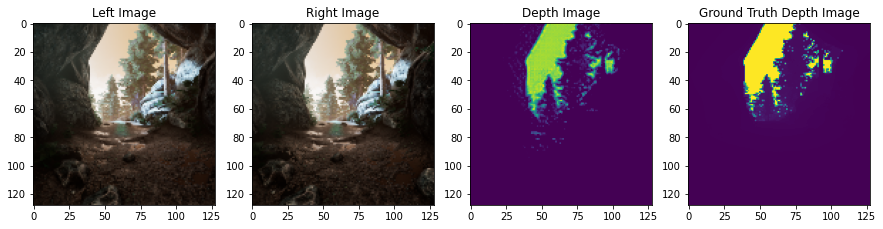

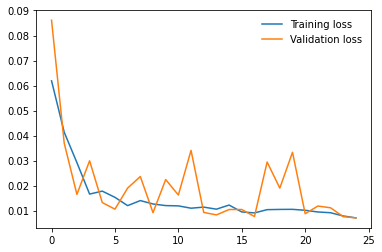

Epoch: 26/100.. Training Loss: 0.007108.. Validation Loss: 0.006214
loss decreased from 0.007122 to 0.006214 -> saving best model.


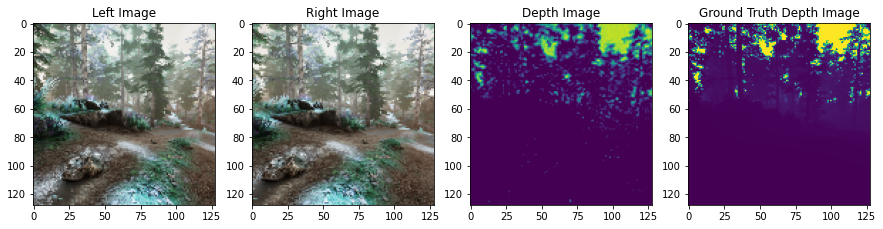

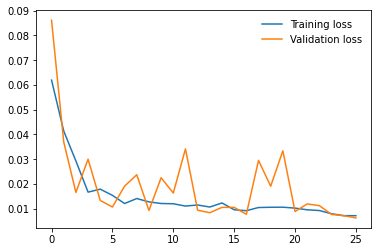

Epoch: 27/100.. Training Loss: 0.007392.. Validation Loss: 0.006054
loss decreased from 0.006214 to 0.006054 -> saving best model.


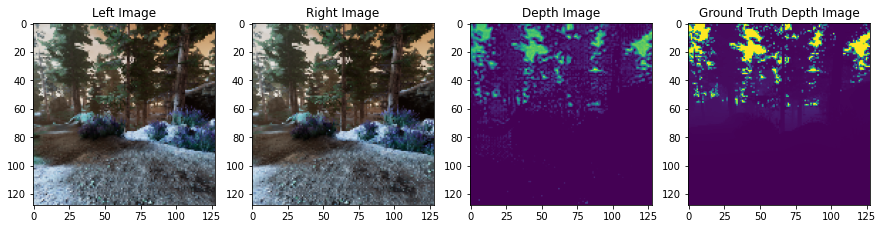

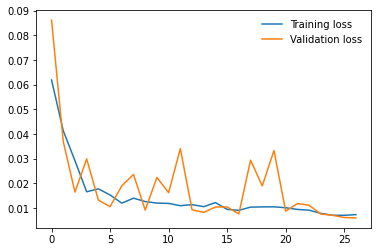

Epoch: 28/100.. Training Loss: 0.007288.. Validation Loss: 0.006588


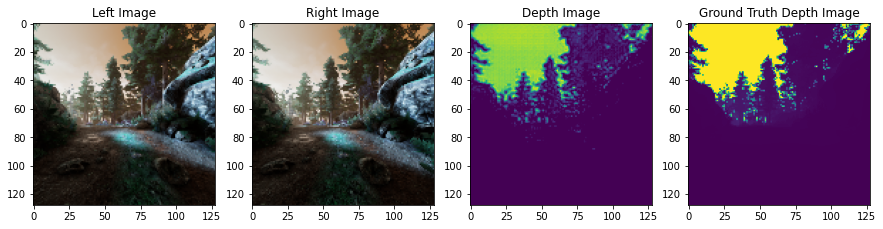

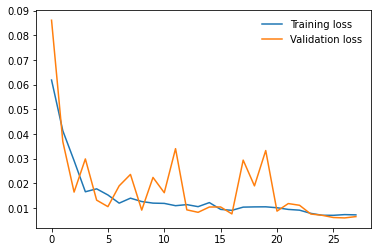

Epoch: 29/100.. Training Loss: 0.007193.. Validation Loss: 0.006264


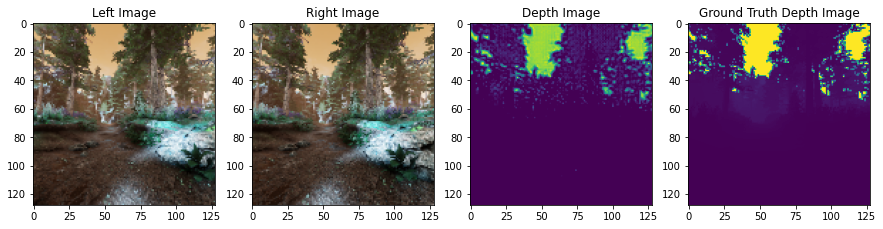

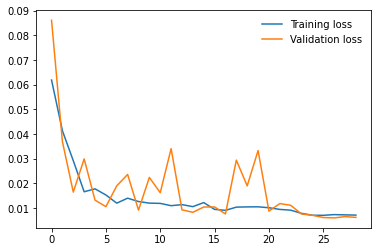

Epoch: 30/100.. Training Loss: 0.006708.. Validation Loss: 0.007235


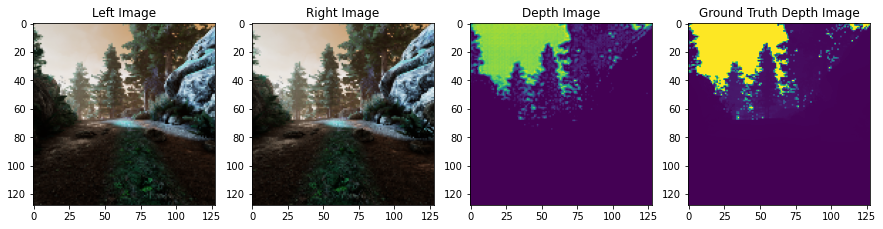

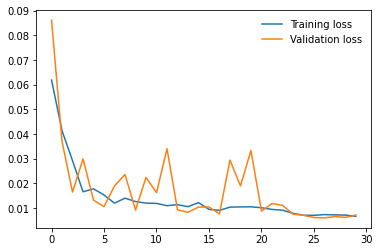

Epoch: 31/100.. Training Loss: 0.007080.. Validation Loss: 0.006847


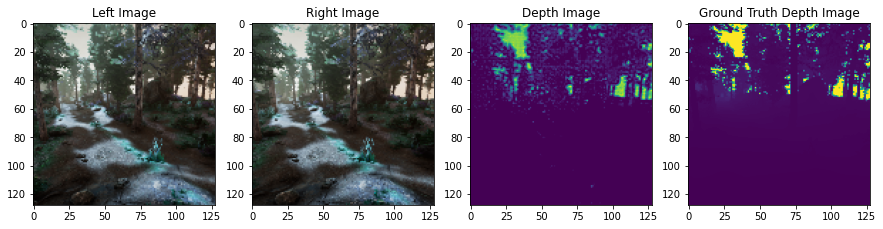

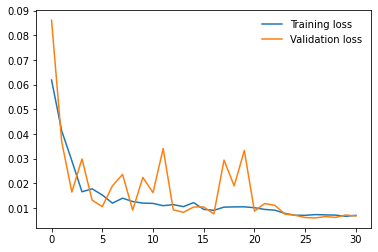

Epoch: 32/100.. Training Loss: 0.006791.. Validation Loss: 0.006916


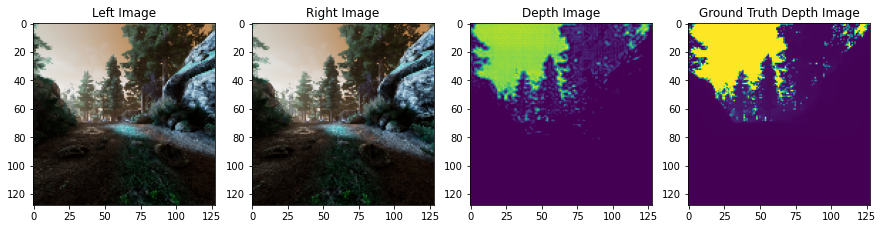

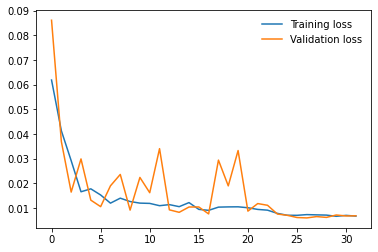

Epoch: 33/100.. Training Loss: 0.006960.. Validation Loss: 0.010441
Epoch    33: reducing learning rate of group 0 to 1.0000e-05.


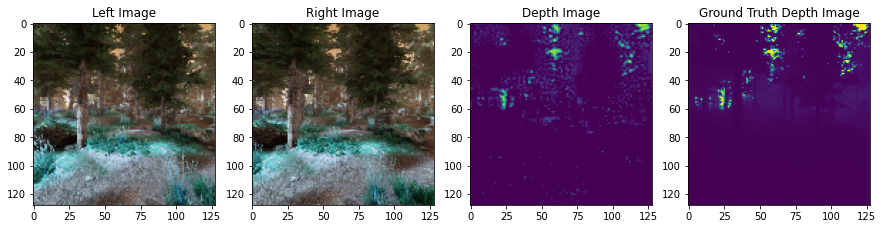

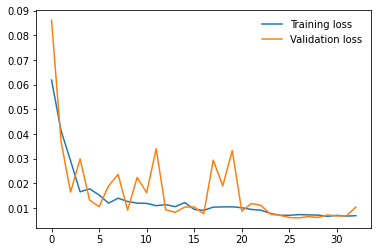

Epoch: 34/100.. Training Loss: 0.006774.. Validation Loss: 0.005902
loss decreased from 0.006054 to 0.005902 -> saving best model.


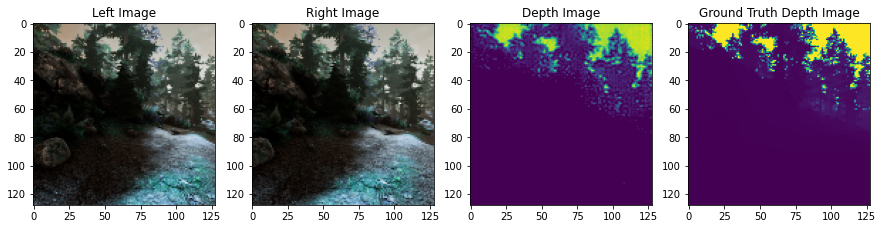

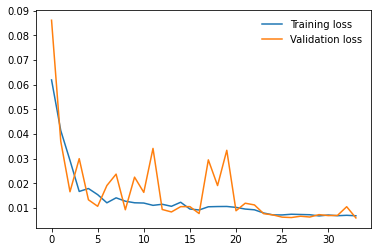

Epoch: 35/100.. Training Loss: 0.006656.. Validation Loss: 0.006559


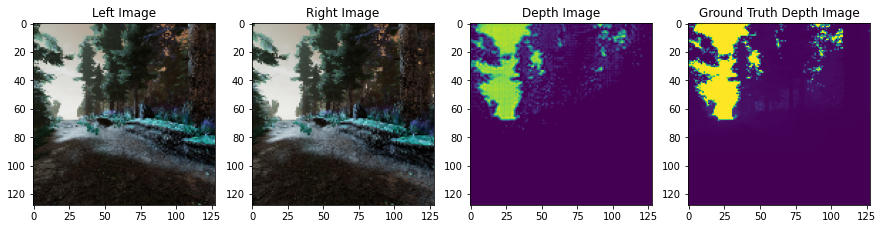

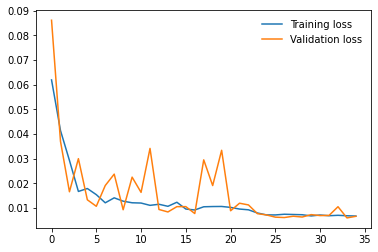

Epoch: 36/100.. Training Loss: 0.006746.. Validation Loss: 0.006165


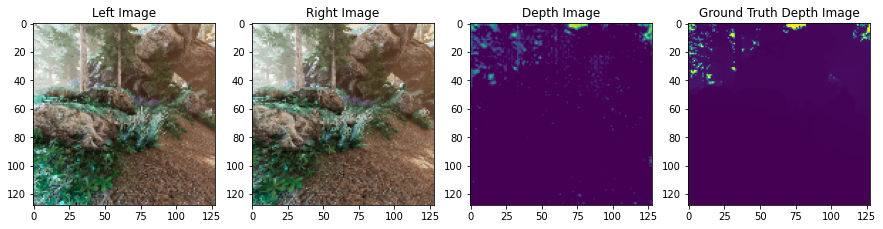

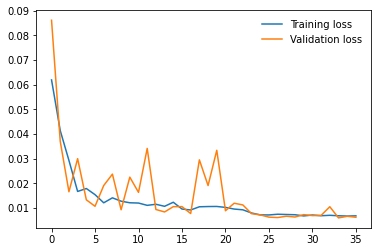

Epoch: 37/100.. Training Loss: 0.006755.. Validation Loss: 0.006810


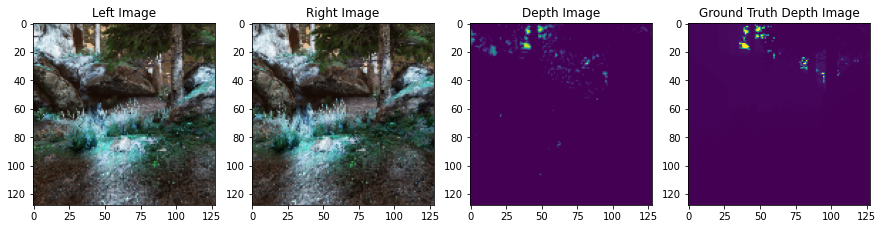

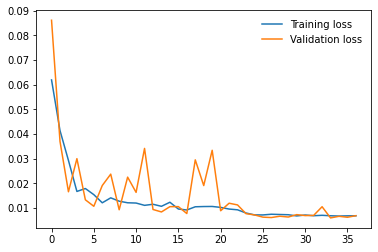

Epoch: 38/100.. Training Loss: 0.006832.. Validation Loss: 0.006056


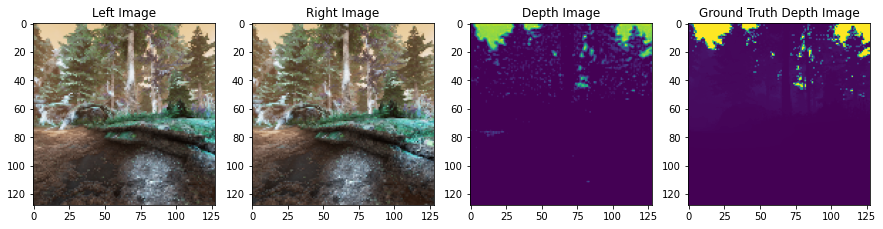

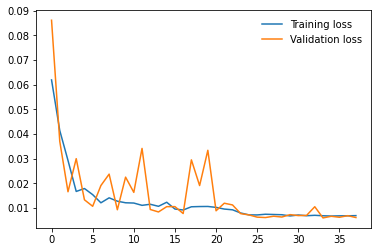

Epoch: 39/100.. Training Loss: 0.006692.. Validation Loss: 0.006333


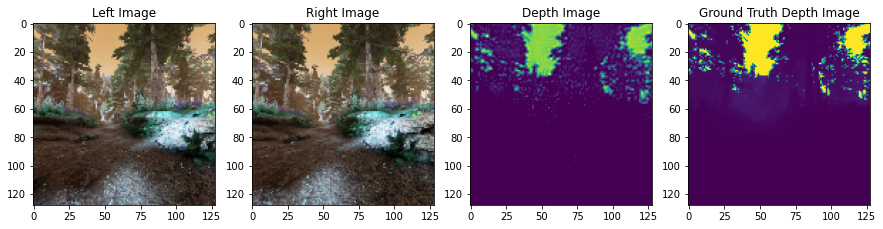

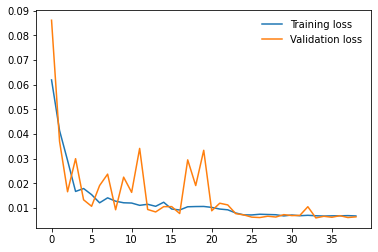

Epoch: 40/100.. Training Loss: 0.006771.. Validation Loss: 0.007147
Epoch    40: reducing learning rate of group 0 to 1.0000e-06.


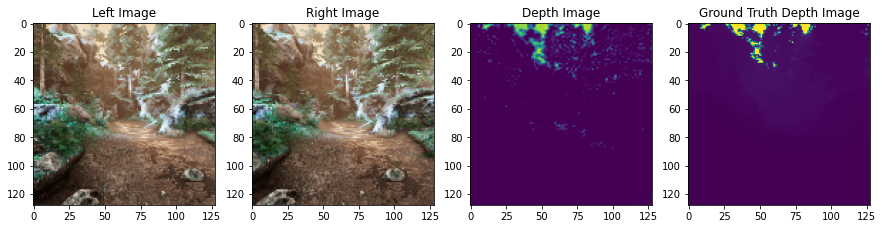

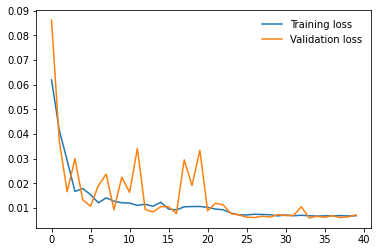

Epoch: 41/100.. Training Loss: 0.006405.. Validation Loss: 0.005878
loss decreased from 0.005902 to 0.005878 -> saving best model.


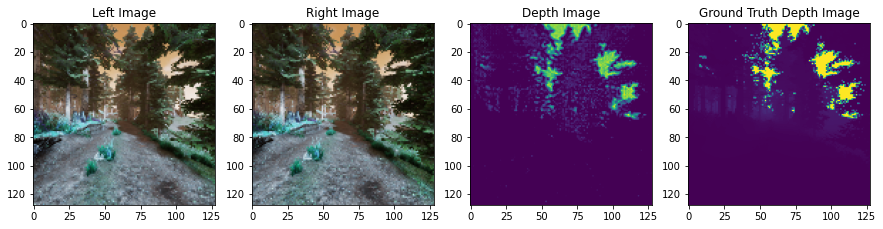

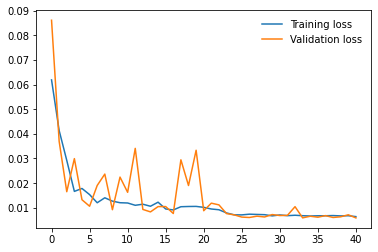

Epoch: 42/100.. Training Loss: 0.006619.. Validation Loss: 0.006653


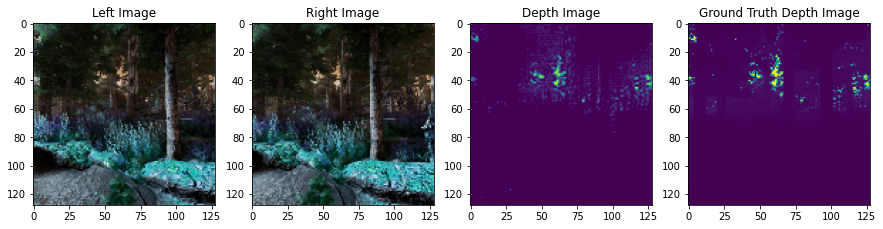

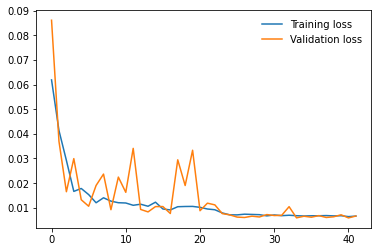

Epoch: 43/100.. Training Loss: 0.006536.. Validation Loss: 0.005987


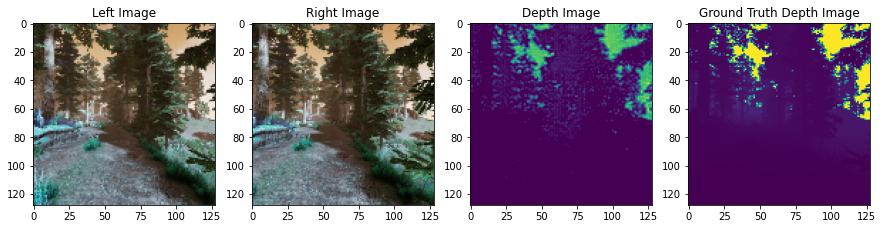

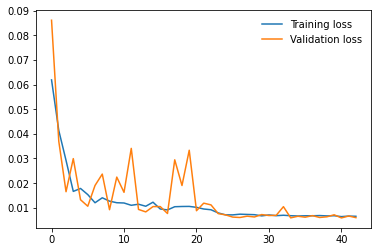

Epoch: 44/100.. Training Loss: 0.006589.. Validation Loss: 0.007094


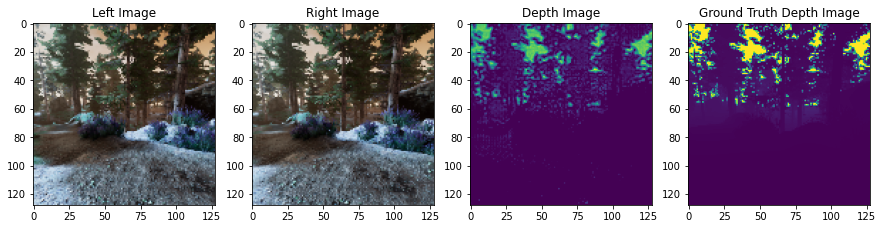

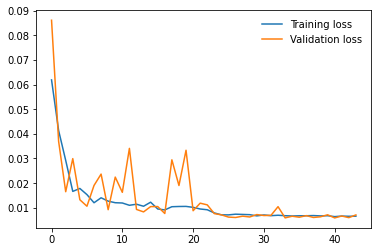

Epoch: 45/100.. Training Loss: 0.006599.. Validation Loss: 0.006473


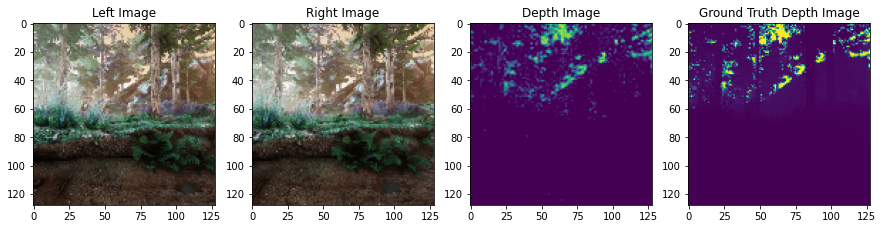

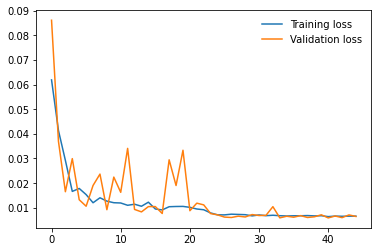

Epoch: 46/100.. Training Loss: 0.006456.. Validation Loss: 0.006161


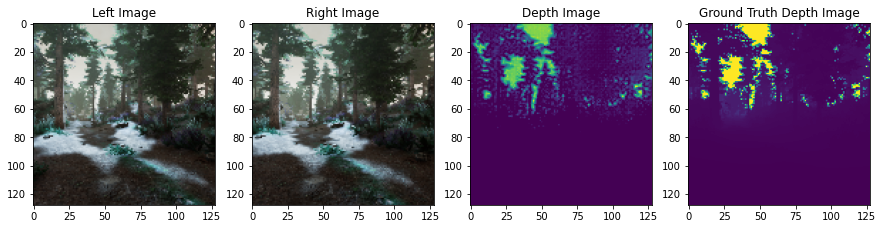

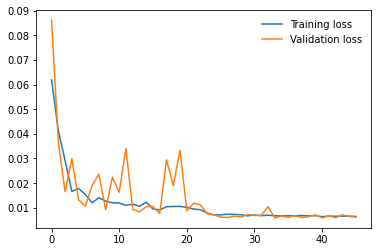

Epoch: 47/100.. Training Loss: 0.006537.. Validation Loss: 0.009011
Epoch    47: reducing learning rate of group 0 to 1.0000e-07.


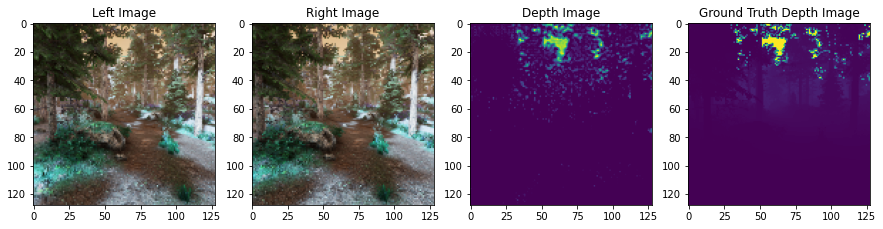

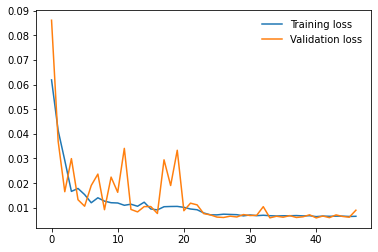

Epoch: 48/100.. Training Loss: 0.006624.. Validation Loss: 0.006403


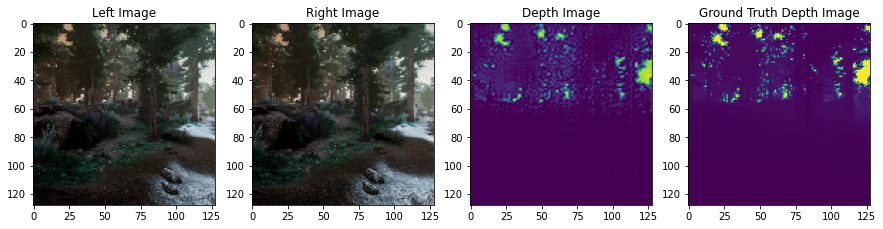

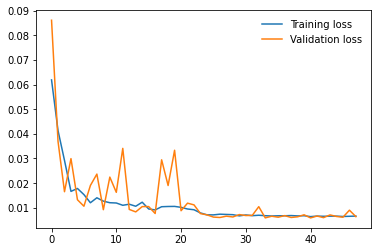

Epoch: 49/100.. Training Loss: 0.006556.. Validation Loss: 0.006502


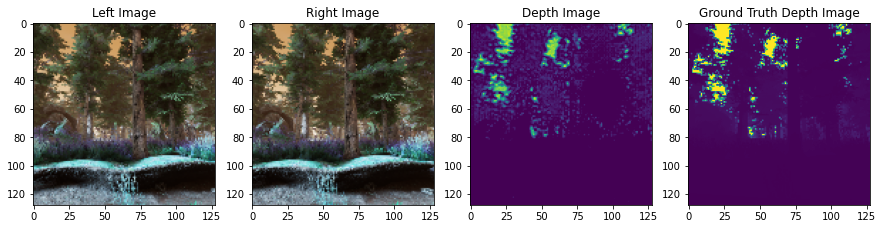

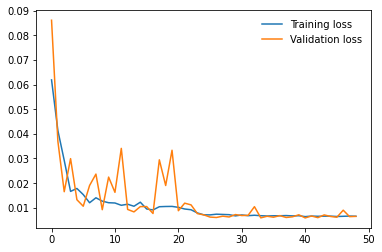

Epoch: 50/100.. Training Loss: 0.006565.. Validation Loss: 0.005856
loss decreased from 0.005878 to 0.005856 -> saving best model.


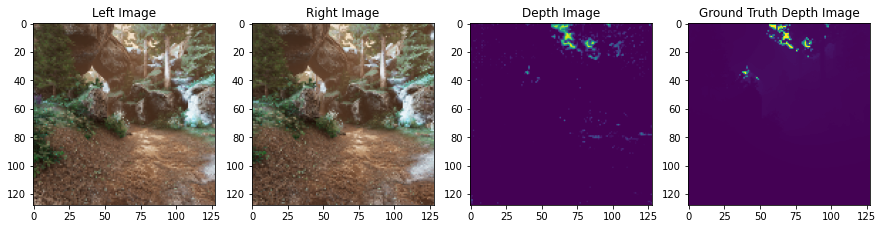

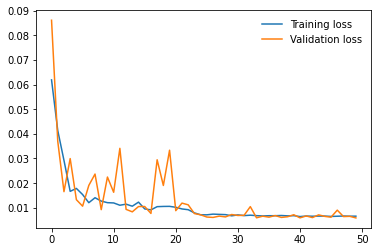

Epoch: 51/100.. Training Loss: 0.006560.. Validation Loss: 0.006802


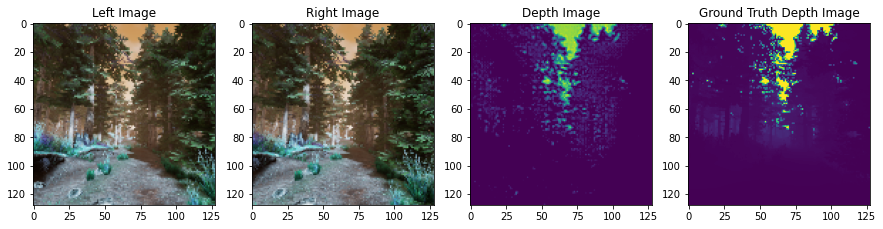

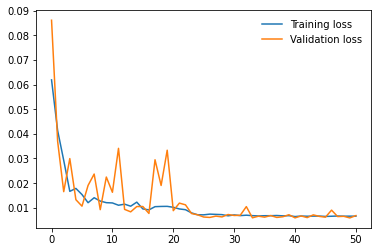

Epoch: 52/100.. Training Loss: 0.006604.. Validation Loss: 0.006203


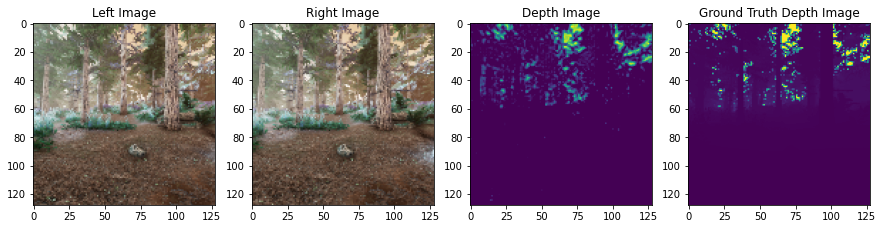

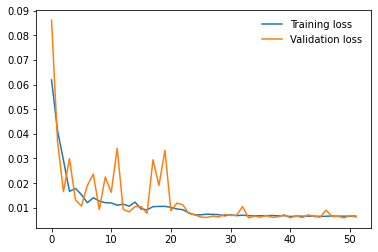

Epoch: 53/100.. Training Loss: 0.006686.. Validation Loss: 0.006388


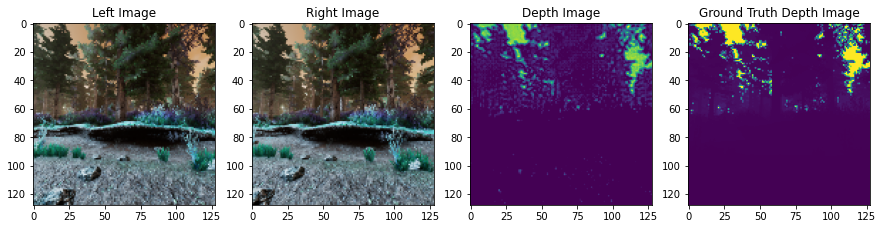

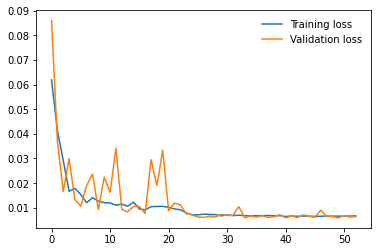

Epoch: 54/100.. Training Loss: 0.006374.. Validation Loss: 0.006418


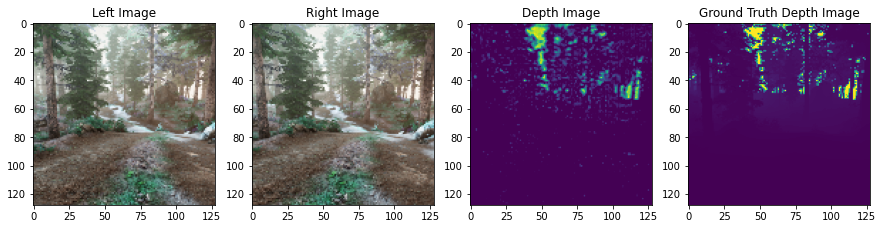

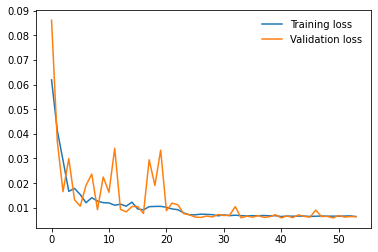

Epoch: 55/100.. Training Loss: 0.006609.. Validation Loss: 0.006906


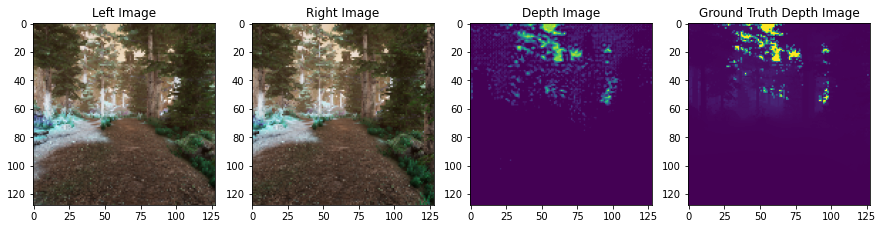

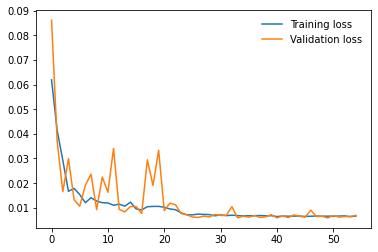

Epoch: 56/100.. Training Loss: 0.006530.. Validation Loss: 0.006568
Epoch    56: reducing learning rate of group 0 to 1.0000e-08.


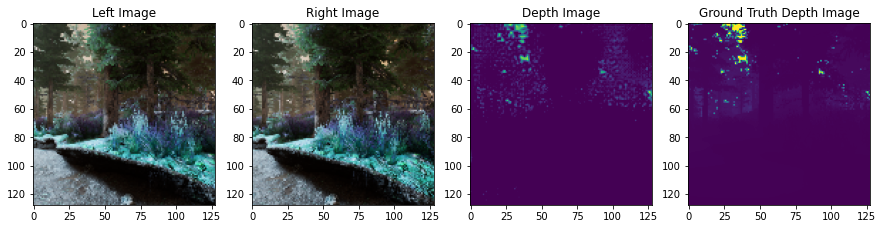

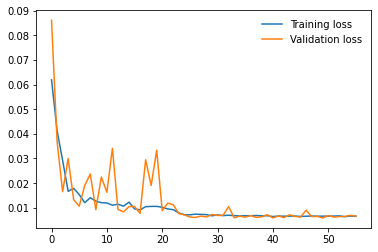

Epoch: 57/100.. Training Loss: 0.006495.. Validation Loss: 0.006223


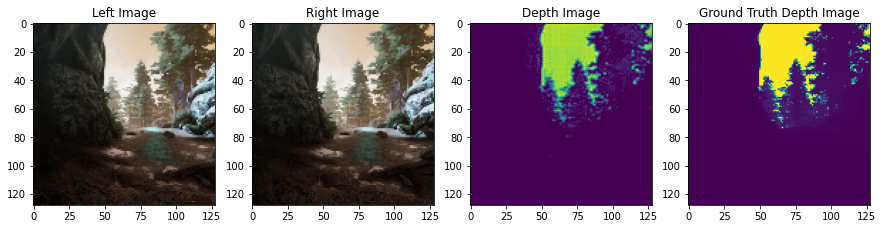

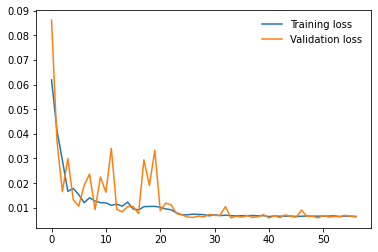

Epoch: 58/100.. Training Loss: 0.006683.. Validation Loss: 0.005903


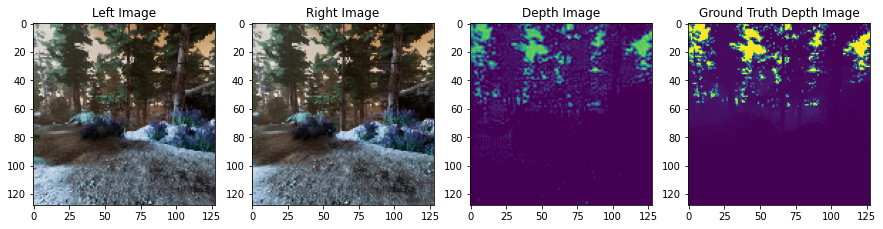

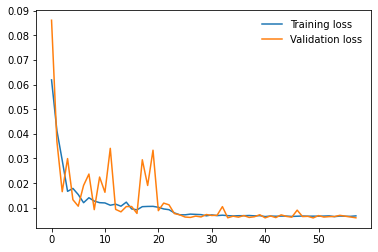

Epoch: 59/100.. Training Loss: 0.006646.. Validation Loss: 0.005568
loss decreased from 0.005856 to 0.005568 -> saving best model.


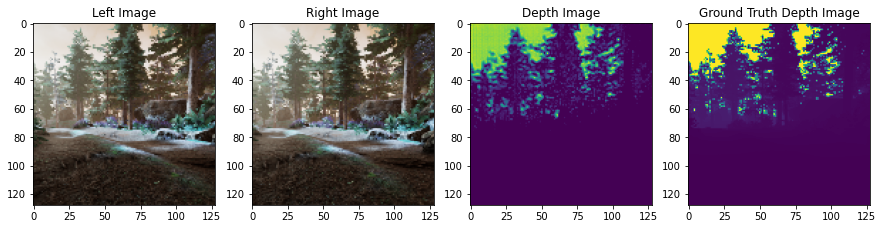

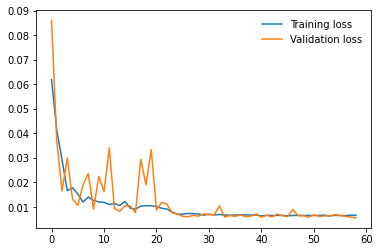

Epoch: 60/100.. Training Loss: 0.006507.. Validation Loss: 0.006080


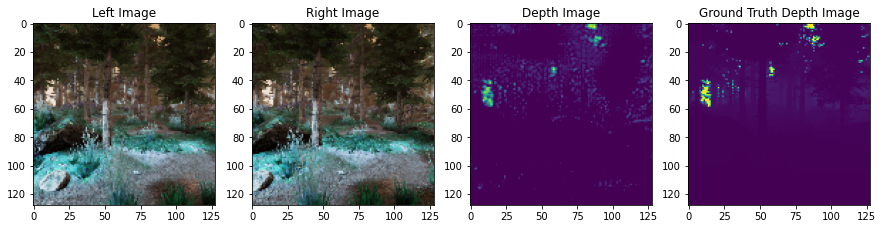

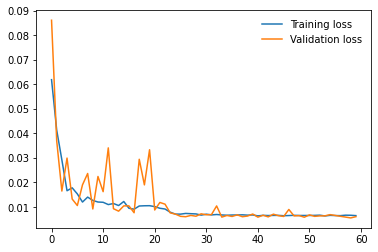

Epoch: 61/100.. Training Loss: 0.006826.. Validation Loss: 0.006822


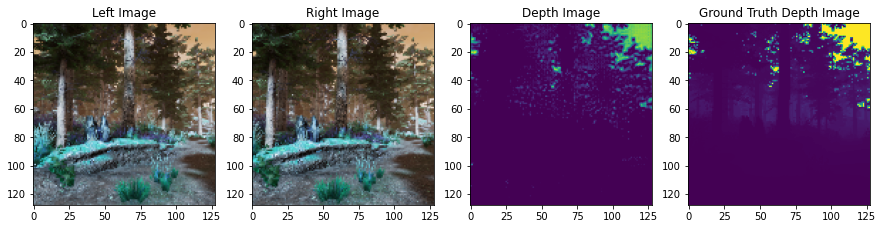

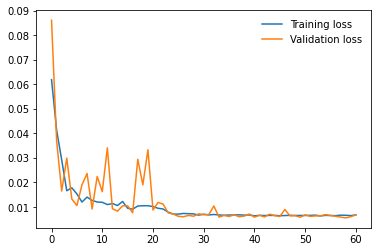

Epoch: 62/100.. Training Loss: 0.006558.. Validation Loss: 0.005920


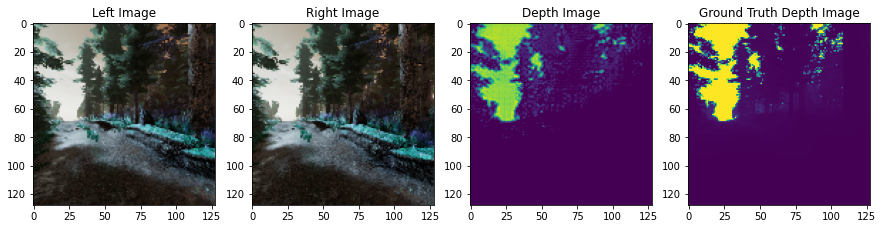

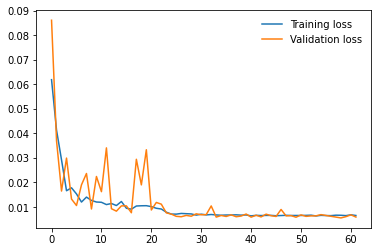

Epoch: 63/100.. Training Loss: 0.006625.. Validation Loss: 0.006121


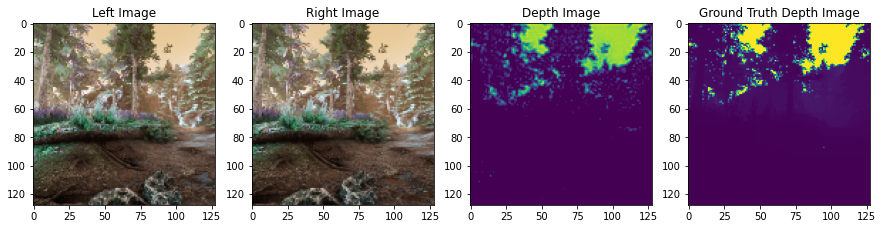

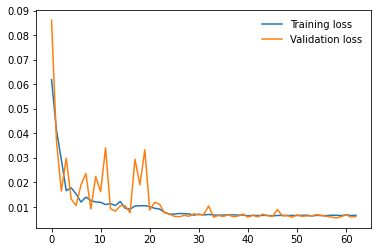

Epoch: 64/100.. Training Loss: 0.006555.. Validation Loss: 0.006037


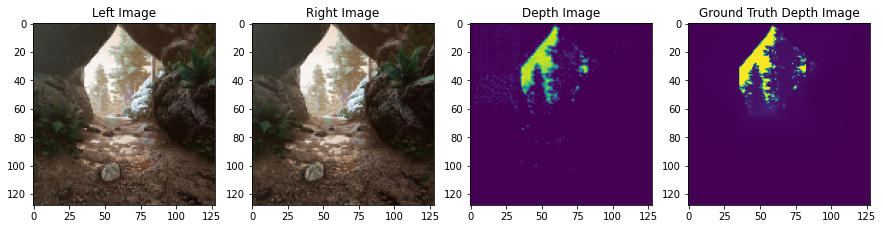

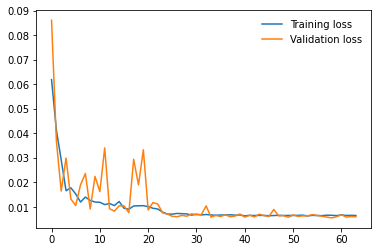

Epoch: 65/100.. Training Loss: 0.006563.. Validation Loss: 0.005924


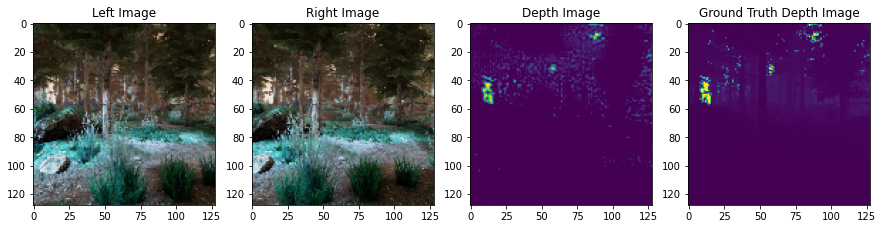

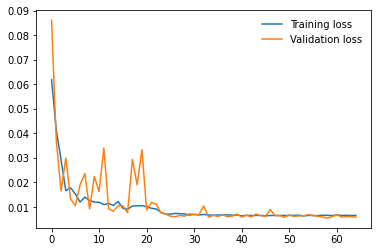

Epoch: 66/100.. Training Loss: 0.006496.. Validation Loss: 0.006286


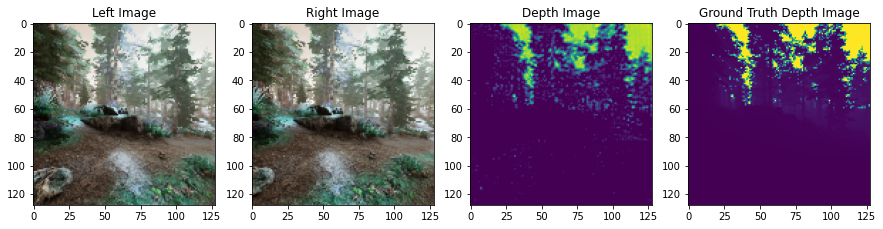

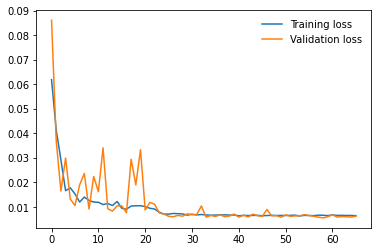

Epoch: 67/100.. Training Loss: 0.006601.. Validation Loss: 0.008678


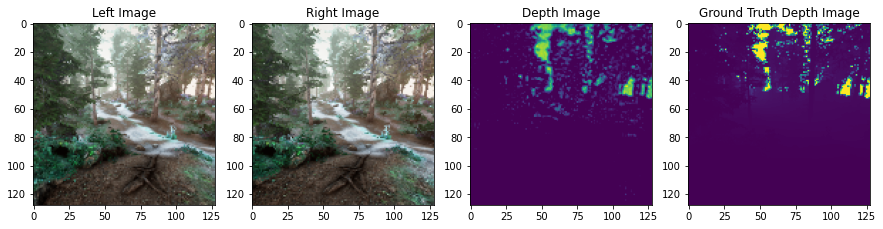

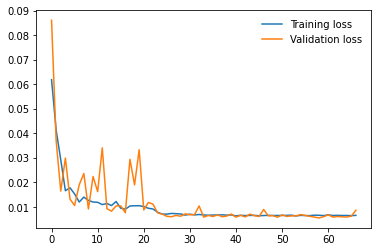

Epoch: 68/100.. Training Loss: 0.006775.. Validation Loss: 0.006552


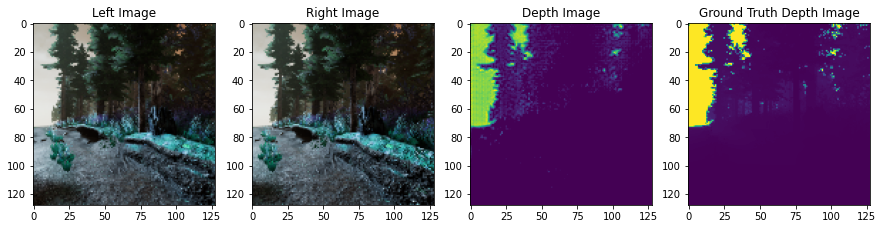

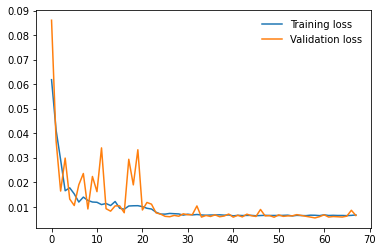

Epoch: 69/100.. Training Loss: 0.006654.. Validation Loss: 0.005891


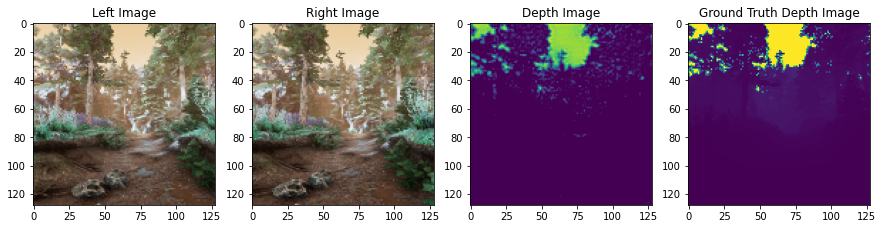

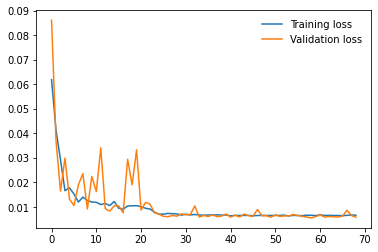

Epoch: 70/100.. Training Loss: 0.006543.. Validation Loss: 0.008586


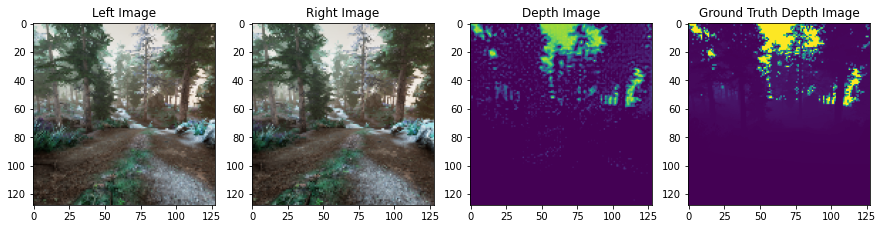

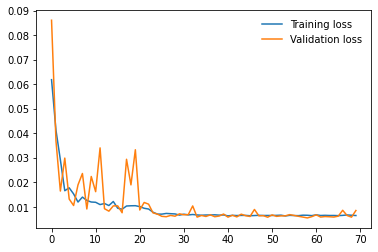

Epoch: 71/100.. Training Loss: 0.006645.. Validation Loss: 0.007471


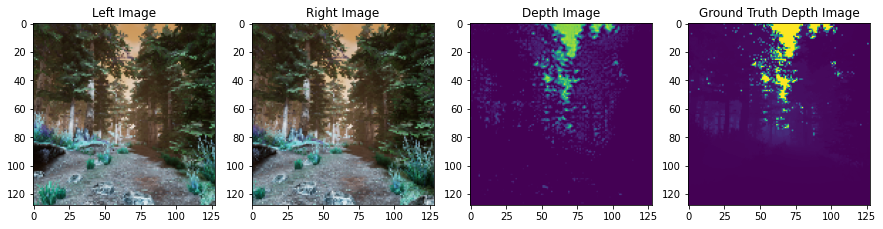

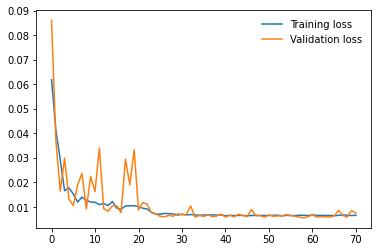

Epoch: 72/100.. Training Loss: 0.006538.. Validation Loss: 0.006801


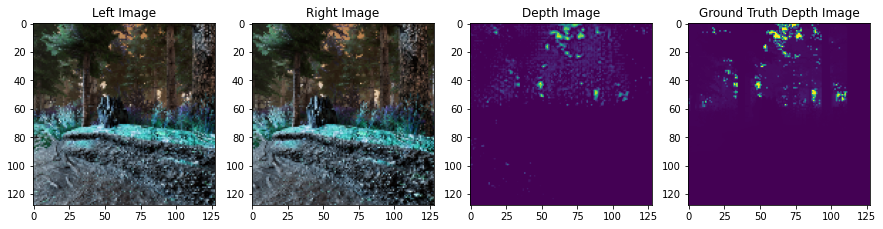

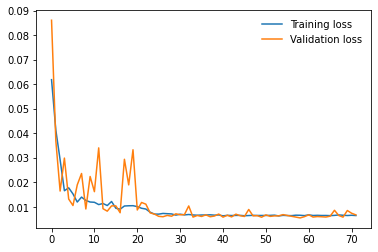

Epoch: 73/100.. Training Loss: 0.006569.. Validation Loss: 0.005894


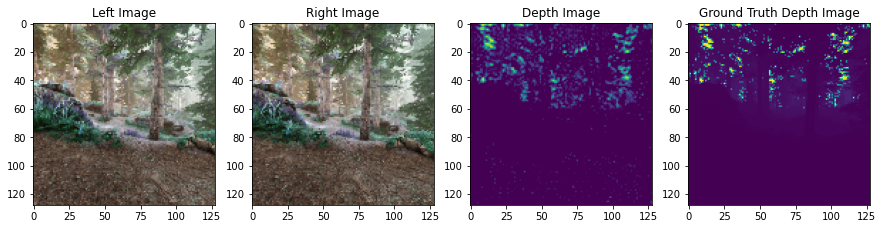

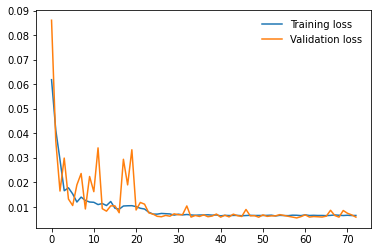

Epoch: 74/100.. Training Loss: 0.006622.. Validation Loss: 0.006692


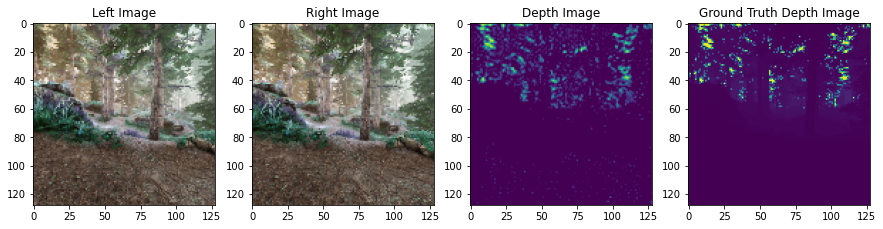

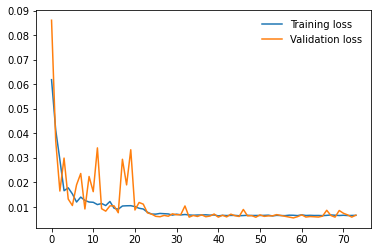

Epoch: 75/100.. Training Loss: 0.006625.. Validation Loss: 0.007021


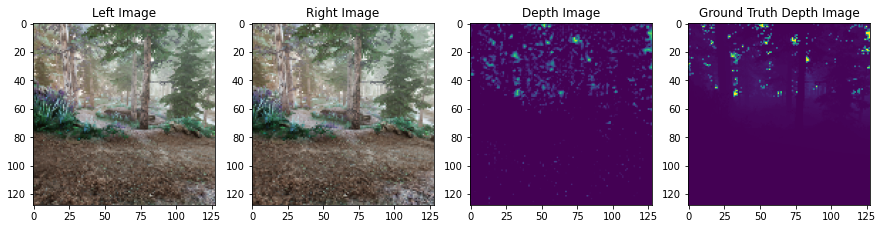

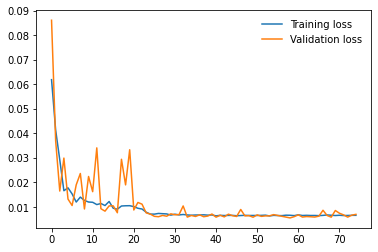

Epoch: 76/100.. Training Loss: 0.006548.. Validation Loss: 0.005764


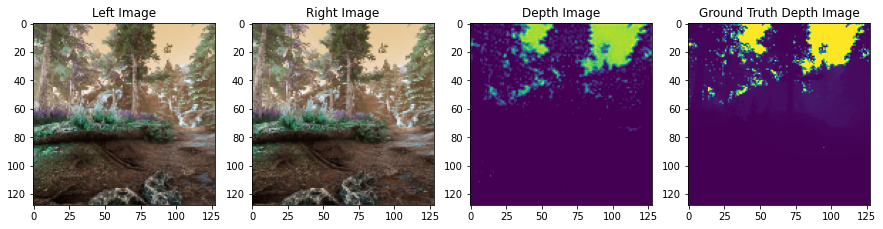

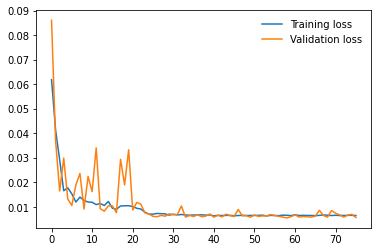

Epoch: 77/100.. Training Loss: 0.006625.. Validation Loss: 0.006355


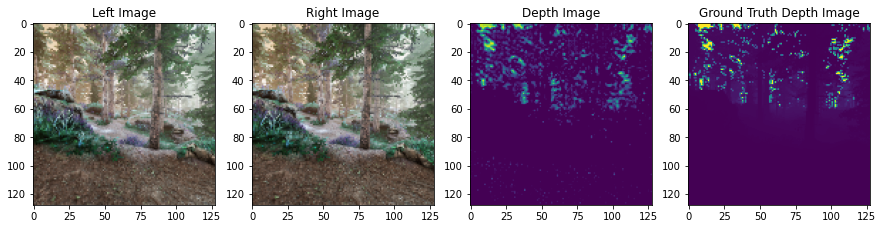

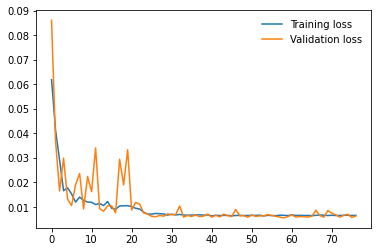

Epoch: 78/100.. Training Loss: 0.006553.. Validation Loss: 0.006454


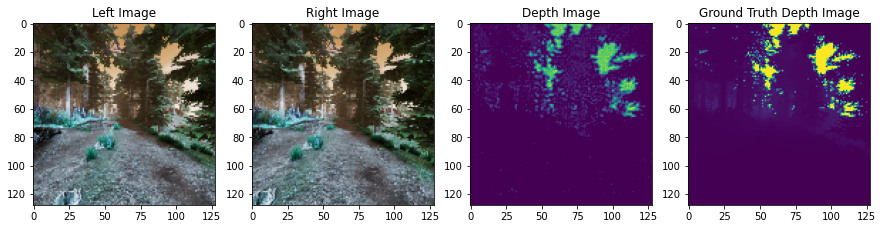

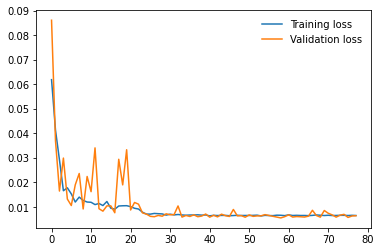

Epoch: 79/100.. Training Loss: 0.006475.. Validation Loss: 0.006139


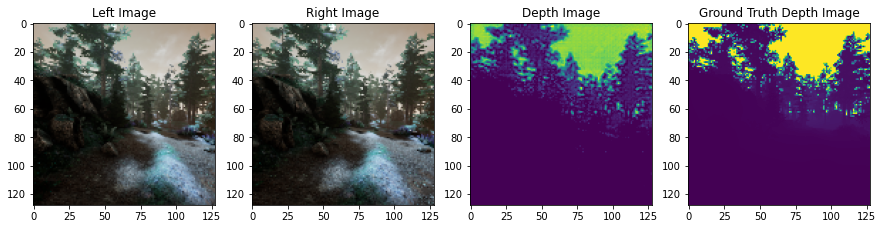

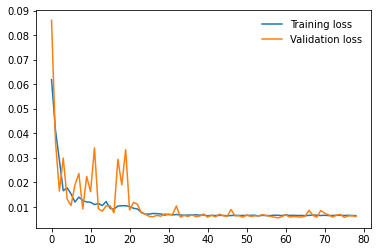

Epoch: 80/100.. Training Loss: 0.006481.. Validation Loss: 0.006021


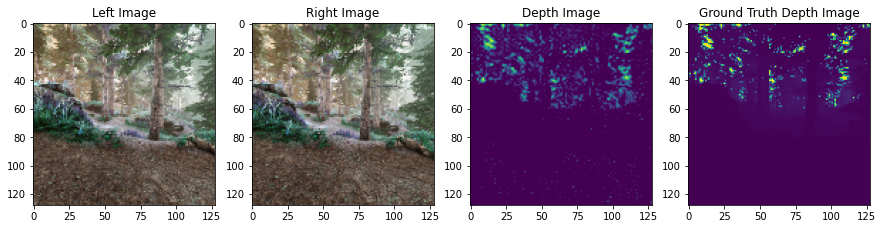

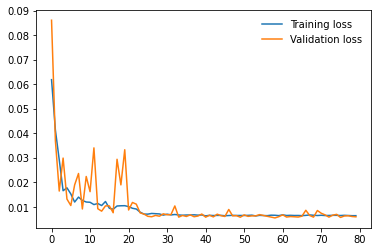

Epoch: 81/100.. Training Loss: 0.006687.. Validation Loss: 0.006373


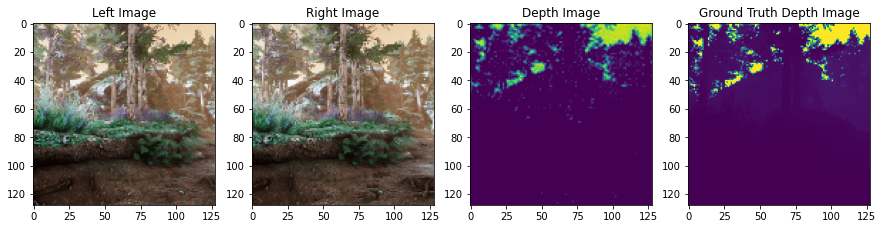

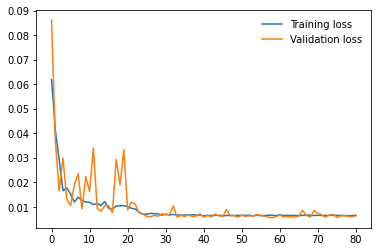

Epoch: 82/100.. Training Loss: 0.006478.. Validation Loss: 0.006644


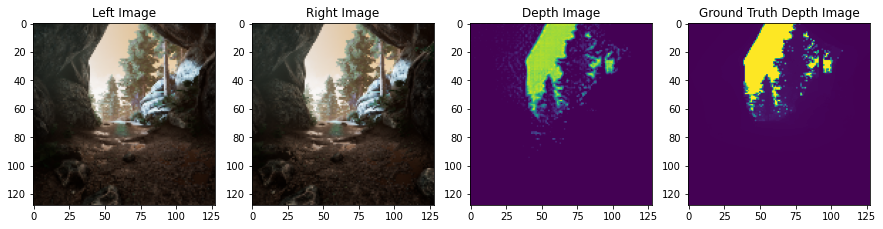

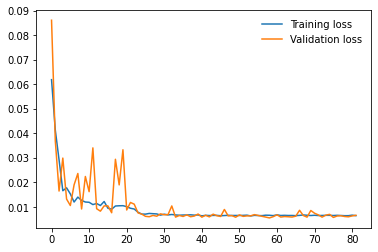

Epoch: 83/100.. Training Loss: 0.006634.. Validation Loss: 0.006085


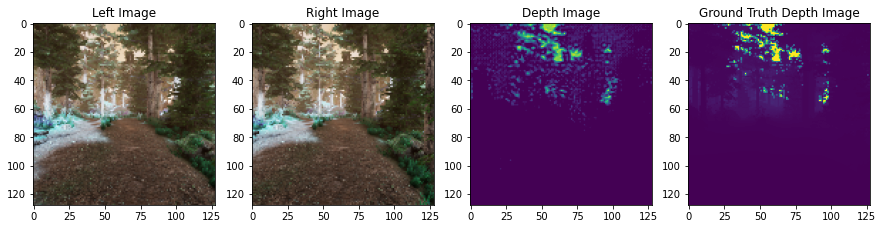

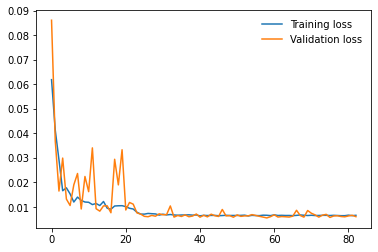

Epoch: 84/100.. Training Loss: 0.006580.. Validation Loss: 0.005869


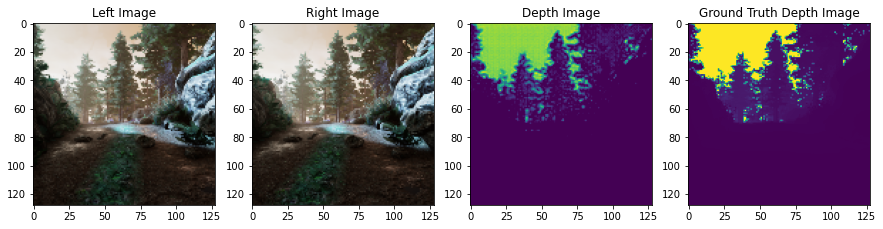

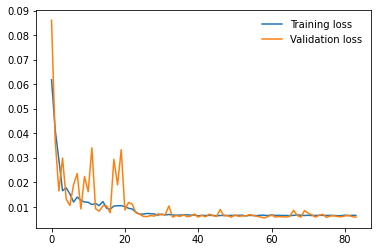

Epoch: 85/100.. Training Loss: 0.006425.. Validation Loss: 0.006415


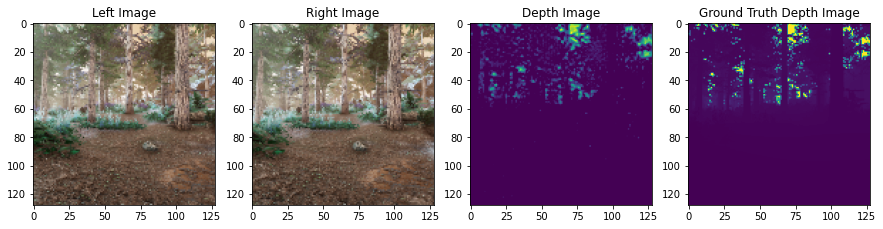

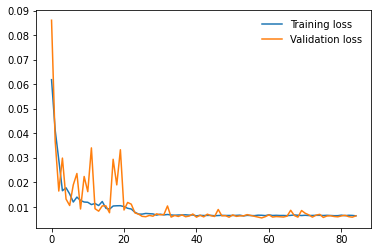

Epoch: 86/100.. Training Loss: 0.006570.. Validation Loss: 0.006093


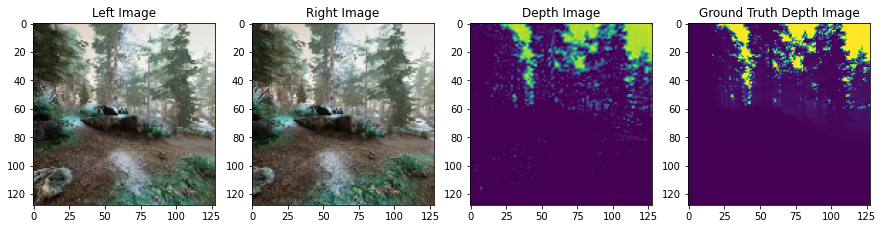

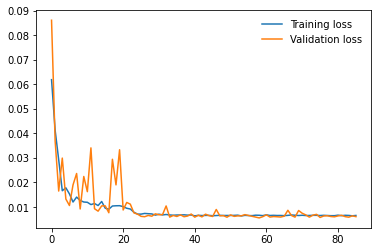

Epoch: 87/100.. Training Loss: 0.006540.. Validation Loss: 0.006142


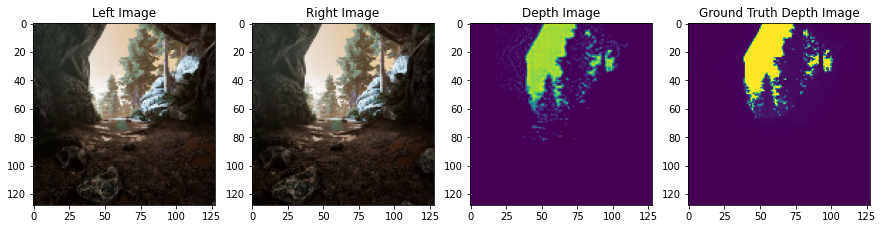

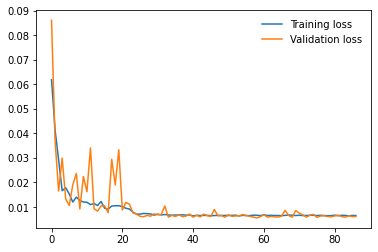

Epoch: 88/100.. Training Loss: 0.006522.. Validation Loss: 0.006195


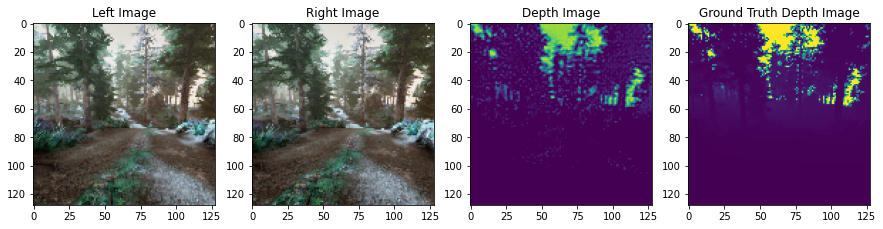

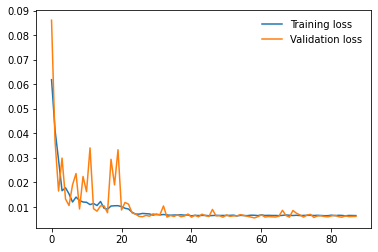

Epoch: 89/100.. Training Loss: 0.006582.. Validation Loss: 0.005868


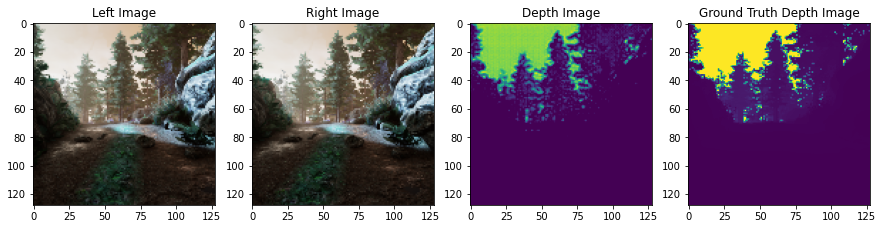

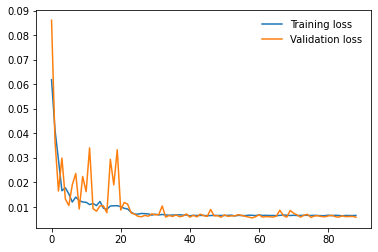

Epoch: 90/100.. Training Loss: 0.006621.. Validation Loss: 0.006613


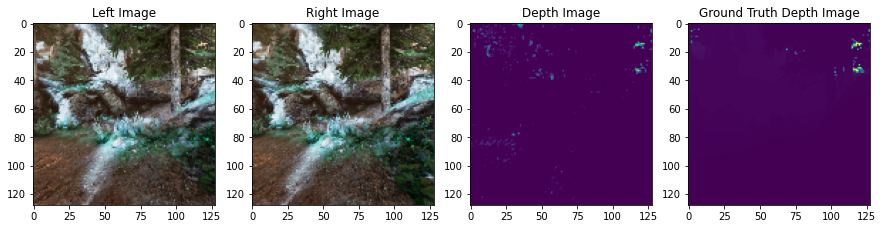

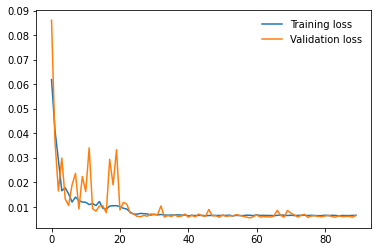

Epoch: 91/100.. Training Loss: 0.006496.. Validation Loss: 0.005777


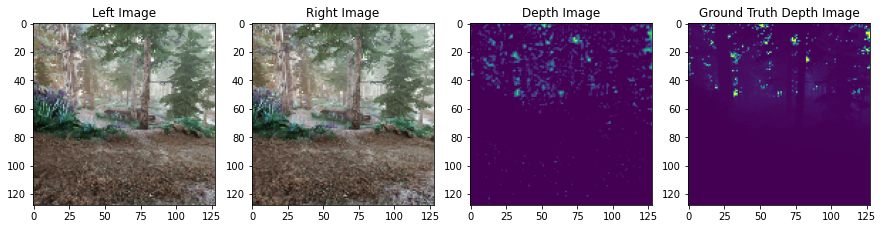

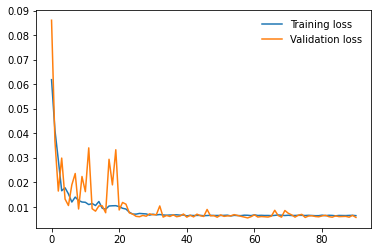

Epoch: 92/100.. Training Loss: 0.006552.. Validation Loss: 0.006218


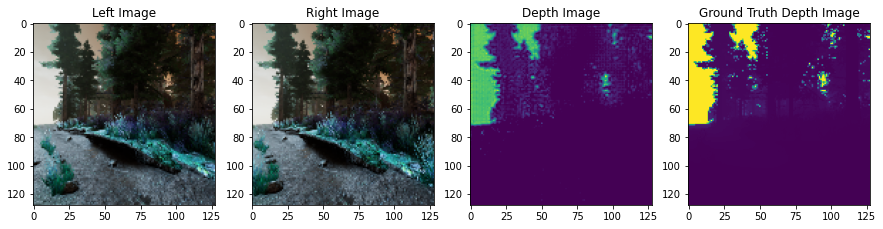

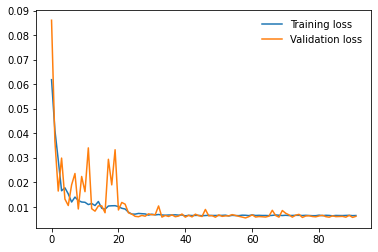

Epoch: 93/100.. Training Loss: 0.006498.. Validation Loss: 0.006578


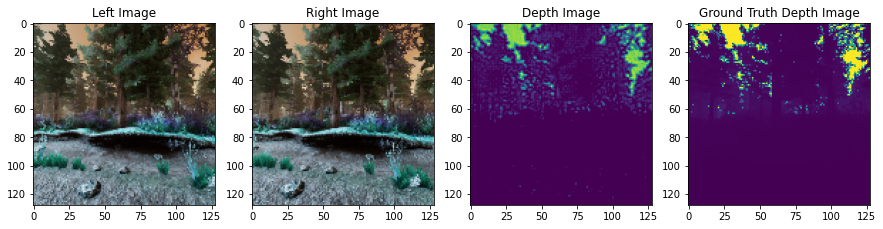

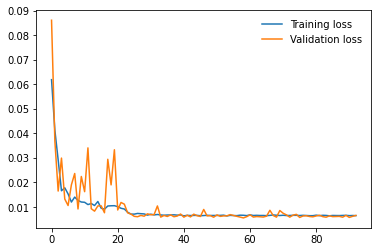

Epoch: 94/100.. Training Loss: 0.006499.. Validation Loss: 0.005711


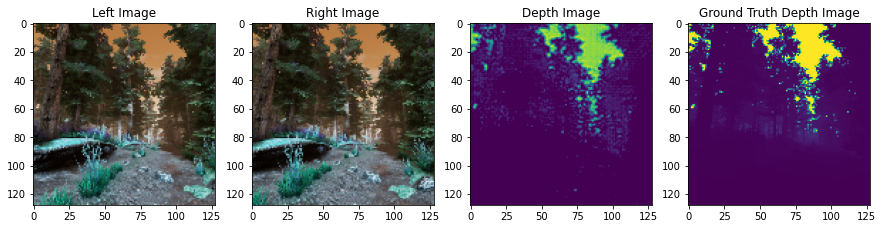

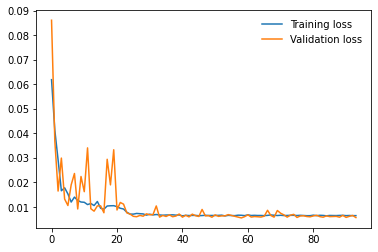

Epoch: 95/100.. Training Loss: 0.006596.. Validation Loss: 0.006059


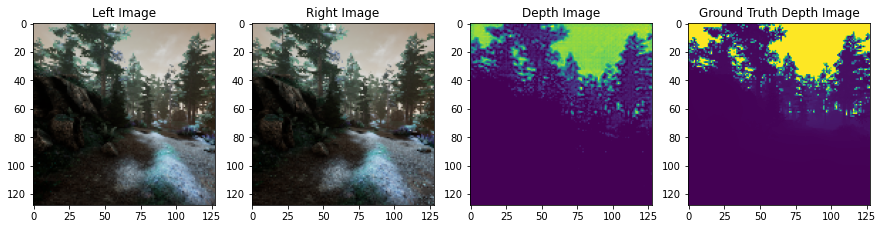

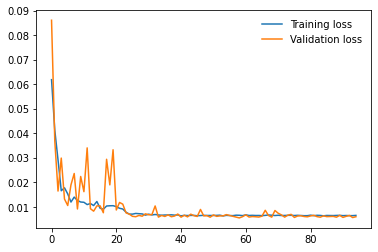

Epoch: 96/100.. Training Loss: 0.006576.. Validation Loss: 0.005781


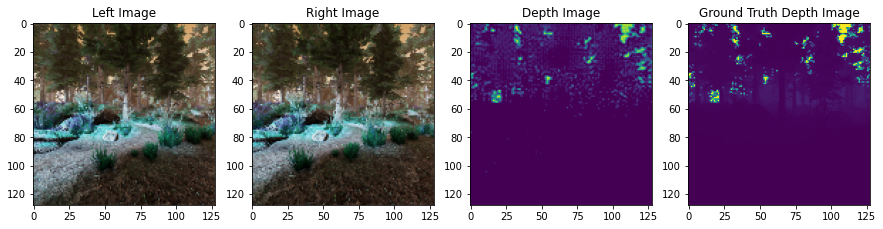

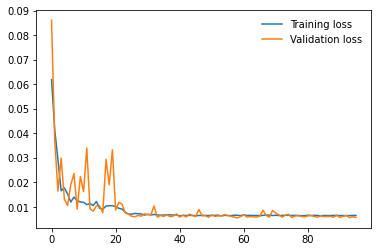

Epoch: 97/100.. Training Loss: 0.006623.. Validation Loss: 0.007142


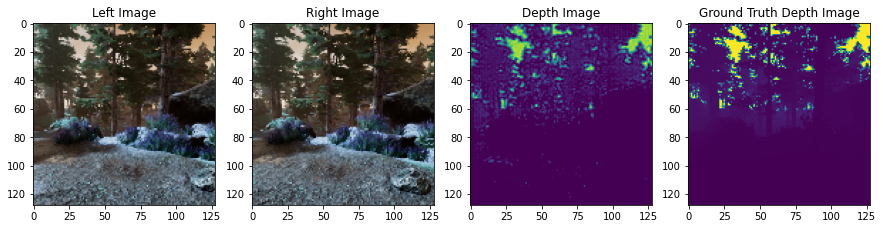

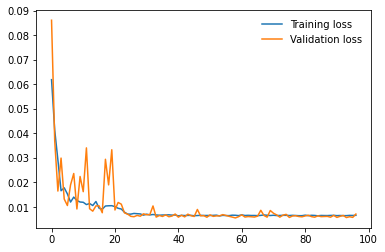

Epoch: 98/100.. Training Loss: 0.006648.. Validation Loss: 0.008349


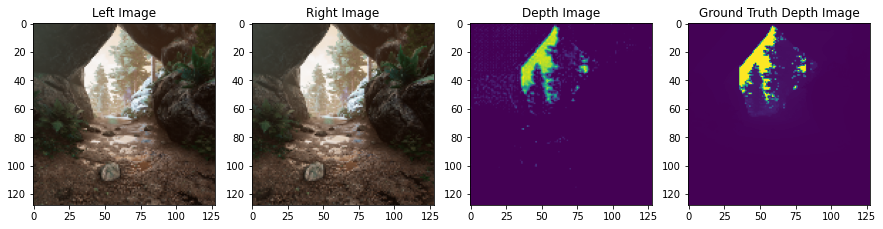

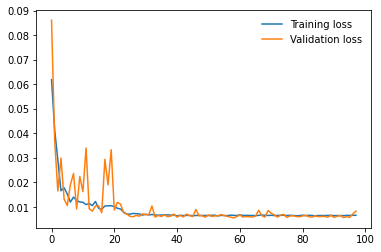

Epoch: 99/100.. Training Loss: 0.006614.. Validation Loss: 0.006268


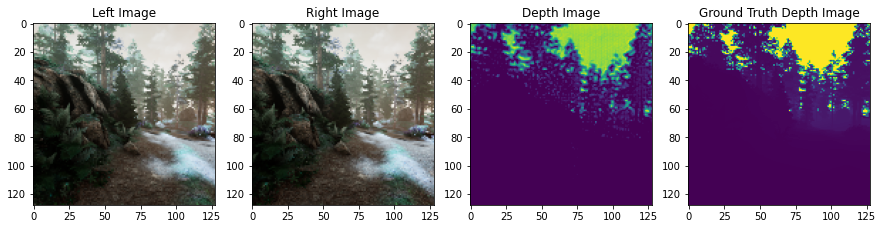

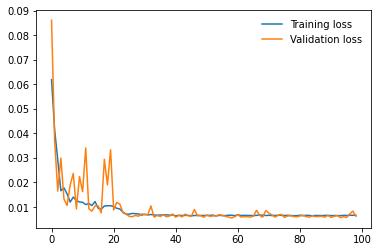

Epoch: 100/100.. Training Loss: 0.006536.. Validation Loss: 0.006362


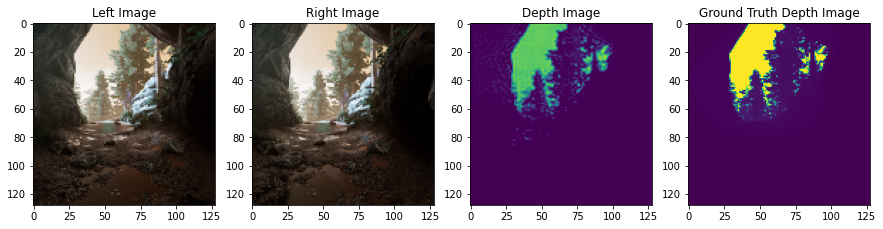

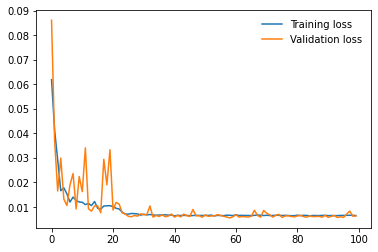

In [13]:
if torch.cuda.is_available():
    inputs["device"] = "cuda"

# # load training and validation losses if available losses.json is available
# if os.path.exists("losses.json"):
#     import json
#     with open("losses.json", "r") as f:
#         losses = json.load(f)
        
#     inputs["training_losses"] = losses["training_losses"]
#     inputs["validation_losses"] = losses["validation_losses"]

train(**inputs)

In [ ]:
wandb.finish()

In [14]:
# save training losses and validation losses in json file
import json

with open("losses_transconv_depthloss.json", "w") as f:
    json.dump({"training_losses": inputs["training_losses"], "validation_losses": inputs["validation_losses"]}, f)

In [15]:
# model = DepthNet(False)
model.load_state_dict(torch.load("best_model_inv_conv.pth"))
left,right, ldepth, rdepth = next(iter(testloader))
x = torch.cat((left, right), dim=1)[0].unsqueeze(0)
x = x.to('cuda')
model = model.to('cuda')
model.eval()
with torch.no_grad():
    pred_depth = model(x)

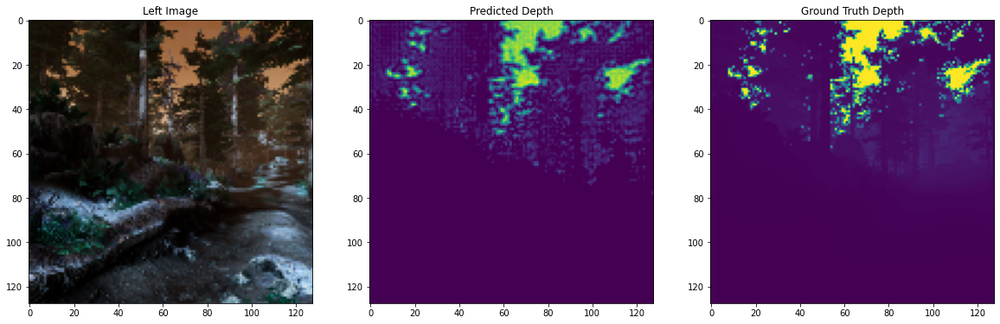

In [16]:
# left, right, ldepth, rdepth = next(iter(testloader))
idx=0
# x = torch.cat((left, right), dim=1).cuda()
# model = model.cuda()
# pred_depth = model(x)
# pred_depth = pred_depth.abs()
# visualize
plt.figure(figsize=(20, 10))
plt.subplot(1, 3, 1)
plt.imshow(left[idx].permute(1, 2, 0).cpu().detach().numpy())
plt.title("Left Image")
plt.subplot(1, 3, 2)
plt.imshow(pred_depth[idx].squeeze().cpu().detach().numpy()*dataset.max_depth)
plt.title("Predicted Depth")
plt.subplot(1, 3, 3)
plt.imshow(ldepth[idx].squeeze().cpu().detach().numpy()*dataset.max_depth)
plt.title("Ground Truth Depth")
plt.show()

In [ ]:
left[1].shape

In [ ]:

# display left image right and predicted depth on the same line using matplotlib
for i in range(4):
    fig, ax = plt.subplots(1, 4, figsize=(20, 20))
    ax[0].imshow(left[i].permute(1, 2, 0))
    ax[0].axis("off")
    ax[0].set_title("Left Image")
    ax[1].imshow(right[i].permute(1, 2, 0))
    ax[1].axis("off")
    ax[1].set_title("Right Image")
    ax[2].imshow(pred_depth[i].squeeze().cpu().detach().numpy()*dataset.max_depth)
    ax[2].axis("off")
    ax[2].set_title("Predicted Depth")
    ax[3].imshow(ldepth[i].squeeze().cpu().detach().numpy()*dataset.max_depth)
    ax[3].axis("off")
    ax[3].set_title("Ground Truth Depth")
    plt.show()

In [17]:
# test the model on the test set
test_loss = 0
model.eval()
criterion = DepthLoss()
model = model.cuda()
with torch.no_grad():
    for left, right, ldepth, rdepth in testloader:
        # concatenate left and right images
        x = torch.cat((left, right), dim=1)
        x = x.to('cuda')
        ldepth = ldepth.to('cuda')

        pred_depth = model(x)
        loss = criterion(pred_depth, ldepth)

        test_loss += loss.item()
        
print(f"Test Loss: {test_loss/len(testloader):.4f}")

Test Loss: 0.0080


In [23]:
(pred_depth[0].squeeze().cpu().detach().numpy()*dataset.max_depth).min()

0.06528

In [32]:
torch.sum(pred_depth[0] - ldepth[0]).abs()*dataset.max_depth

tensor(2845247.7500, device='cuda:0')

In [25]:
ldepth[0]*dataset.max_depth

tensor([[[  248.5000,   254.5000,   259.0000,  ..., 65216.0000,
          65280.0000, 65280.0000],
         [  245.7500,   250.0000,   255.5000,  ..., 65280.0000,
          49604.0000, 49668.0000],
         [  243.0000,   247.5000,   252.0000,  ..., 18408.0000,
           2804.0000,  2784.0000],
         ...,
         [  170.7500,   172.0000,   172.7500,  ...,   226.5000,
            227.7500,   229.2500],
         [  169.2500,   169.7500,   170.7500,  ...,   223.0000,
            224.5000,   225.7500],
         [  167.5000,   167.5000,   168.5000,  ...,   219.2500,
            221.0000,   222.0000]]], device='cuda:0')

In [27]:
6.5280e-02*65280.0

4261.4784